<a href="https://colab.research.google.com/github/trinovita03/Pneumonia-Object-Detection/blob/main/Detection%20Penumonia%20with%20Faster%20R-CNN%20and%20EffisienNet-B0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install pydicom opencv-python pandas tqdm


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 28.2 MB/s eta 0:00:00


In [3]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [4]:
base_path = "/content/drive/MyDrive/RSNA_Pneumonia"
train_dicom_path = f"{base_path}/stage_2_train_images"
label_csv_path = f"{base_path}/stage_2_train_labels.csv"
output_jpg_path = f"{base_path}/train_jpg"


In [5]:
!pip install pydicom opencv-python tqdm pandas


In [6]:
#MENAMPILKAN DATA CSV
import pandas as pd
labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
df = pd.read_csv(labels_path)
df.head()


,patientId,x,y,width,height,Target
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,NaN,NaN,NaN,NaN,0
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,NaN,NaN,NaN,NaN,0
2,00322d4d-1c29-4943-afc9-b6754be640eb,NaN,NaN,NaN,NaN,0
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,NaN,NaN,NaN,NaN,0
4,00436515-870c-4b36-a041-de91049b9ab4,264.0,152.0,213.0,379.0,1


In [7]:
import pandas as pd
labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
df = pd.read_csv(labels_path)
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30227 entries, 0 to 30226
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   patientId  30227 non-null  object 
 1   x          9555 non-null   float64
 2   y          9555 non-null   float64
 3   width      9555 non-null   float64
 4   height     9555 non-null   float64
 5   Target     30227 non-null  int64  
dtypes: float64(4), int64(1), object(1)
memory usage: 1.4+ MB


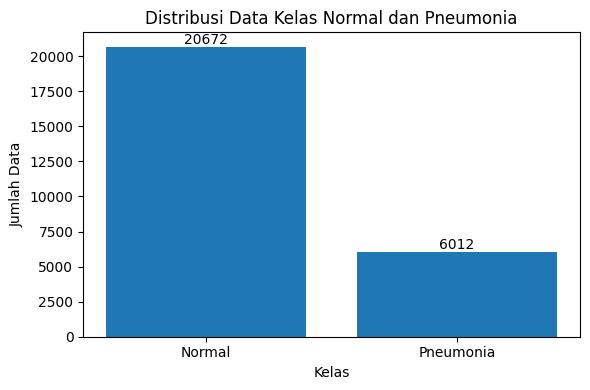

In [8]:
import matplotlib.pyplot as plt

# Data distribusi kelas
labels = ["Normal", "Pneumonia"]
counts = [20672, 6012]

# Membuat grafik batang
plt.figure(figsize=(6, 4))
plt.bar(labels, counts)
plt.title("Distribusi Data Kelas Normal dan Pneumonia")
plt.xlabel("Kelas")
plt.ylabel("Jumlah Data")

# Menampilkan jumlah di atas batang
for i, value in enumerate(counts):
    plt.text(i, value, str(value), ha='center', va='bottom')

plt.tight_layout()
plt.show()


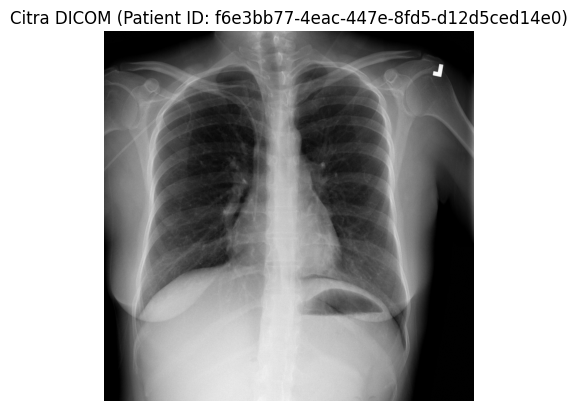

In [ ]:
import os
import pydicom
import matplotlib.pyplot as plt

dicom_dir = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_images"

# Ambil 1 file DICOM pertama
sample_file = os.listdir(dicom_dir)[0]
sample_path = os.path.join(dicom_dir, sample_file)

dcm = pydicom.dcmread(sample_path)

plt.imshow(dcm.pixel_array, cmap='gray')
plt.title(f"Citra DICOM (Patient ID: {dcm.PatientID})")
plt.axis('off')
plt.show()


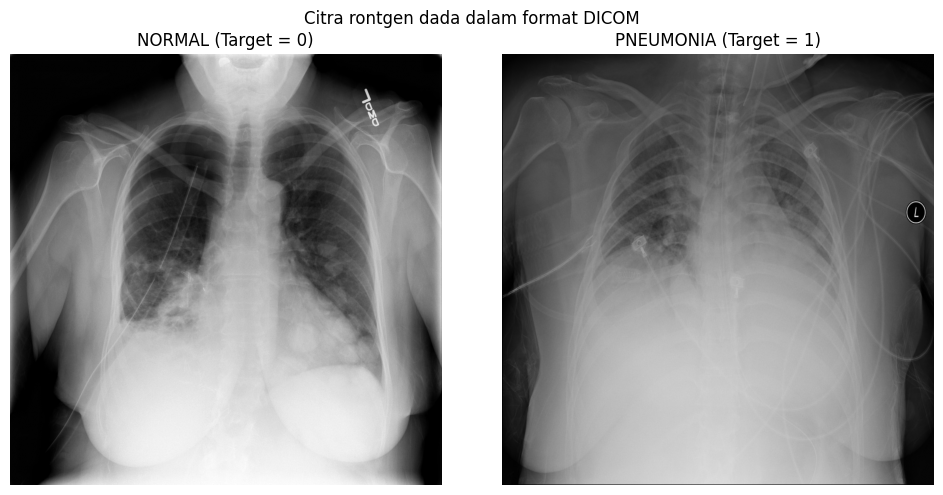

In [ ]:
import pandas as pd
import pydicom
import matplotlib.pyplot as plt
import os
import numpy as np

labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
dicom_dir = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_images"

df = pd.read_csv(labels_path)

normal_id = df[df['Target'] == 0]['patientId'].iloc[0]
pneumonia_id = df[df['Target'] == 1]['patientId'].iloc[0]

def load_dicom(path):
    dcm = pydicom.dcmread(path)
    img = dcm.pixel_array.astype(np.float32)
    img = (img - img.min()) / (img.max() - img.min())
    return img

img_normal = load_dicom(os.path.join(dicom_dir, normal_id + ".dcm"))
img_pneumonia = load_dicom(os.path.join(dicom_dir, pneumonia_id + ".dcm"))

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_normal, cmap="gray")
plt.title("NORMAL (Target = 0)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_pneumonia, cmap="gray")
plt.title("PNEUMONIA (Target = 1)")
plt.axis("off")

# Keterangan format DICOM
plt.suptitle("Citra rontgen dada dalam format DICOM", fontsize=12)

plt.tight_layout()
plt.show()


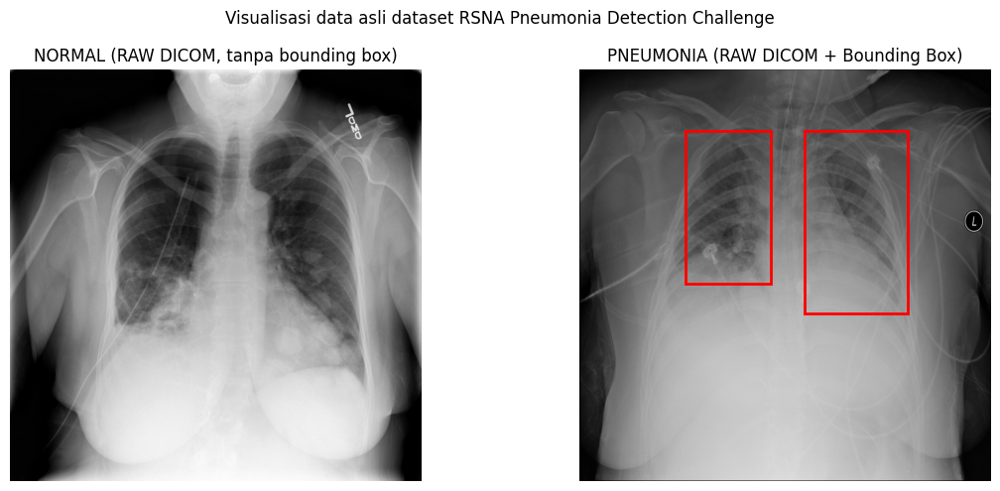

In [ ]:
#MENAMPILKAN BOUNDING BOX DATA ASLI FORMAT DICOM
import pandas as pd
import pydicom
import matplotlib.pyplot as plt
import os
import matplotlib.patches as patches

# Path
labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
dicom_dir = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_images"

# Load label
df = pd.read_csv(labels_path)

# Ambil 1 contoh normal & pneumonia
normal_id = df[df['Target'] == 0]['patientId'].iloc[0]
pneumonia_id = df[df['Target'] == 1]['patientId'].iloc[0]

# Load DICOM RAW
dcm_normal = pydicom.dcmread(os.path.join(dicom_dir, normal_id + ".dcm"))
dcm_pneumonia = pydicom.dcmread(os.path.join(dicom_dir, pneumonia_id + ".dcm"))

img_normal = dcm_normal.pixel_array
img_pneumonia = dcm_pneumonia.pixel_array

# Ambil bounding box pneumonia
bbox_df = df[df['patientId'] == pneumonia_id]

# Plot
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

# ---- NORMAL ----
axs[0].imshow(img_normal, cmap='gray')
axs[0].set_title("NORMAL (RAW DICOM, tanpa bounding box)")
axs[0].axis('off')

# ---- PNEUMONIA ----
axs[1].imshow(img_pneumonia, cmap='gray')

for _, row in bbox_df.iterrows():
    x, y, w, h = row['x'], row['y'], row['width'], row['height']
    rect = patches.Rectangle(
        (x, y), w, h,
        linewidth=2,
        edgecolor='red',
        facecolor='none'
    )
    axs[1].add_patch(rect)

axs[1].set_title("PNEUMONIA (RAW DICOM + Bounding Box)")
axs[1].axis('off')

plt.suptitle(
    "Visualisasi data asli dataset RSNA Pneumonia Detection Challenge",
    fontsize=12
)
plt.tight_layout()
plt.show()


In [ ]:
import os
import cv2
import pydicom
import numpy as np
import time
from tqdm import tqdm

# Folder asal dan tujuan
train_dicom_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_images"
output_jpg_path = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"

# Buat folder output jika belum ada
os.makedirs(output_jpg_path, exist_ok=True)

start_time = time.time()

# Ambil semua file DICOM
dicom_files = [f for f in os.listdir(train_dicom_path) if f.endswith(".dcm")]
print(f"Total file DICOM ditemukan: {len(dicom_files)}")

# Loop konversi semua file DICOM
for f in tqdm(dicom_files, desc="Mengonversi DICOM ke JPG"):
    dicom_path = os.path.join(train_dicom_path, f)
    jpg_path = os.path.join(output_jpg_path, f.replace(".dcm", ".jpg"))

    try:
        # Baca file DICOM
        dcm = pydicom.dcmread(dicom_path)
        img = dcm.pixel_array

        # Normalisasi ke rentang 0–255
        img = cv2.convertScaleAbs(img, alpha=(255.0 / np.max(img)))

        # Simpan sebagai JPG
        cv2.imwrite(jpg_path, img)

    except Exception as e:
        print(f"Gagal konversi {f}: {e}")

end_time = time.time()
processing_time = end_time - start_time

print(f"Waktu pemrosesan: {processing_time:.4f} detik")

print("✅ Konversi selesai! Semua file disimpan dalam folder train_jpg/")



Total file DICOM ditemukan: 26685


Mengonversi DICOM ke JPG:   2%|▏         | 661/26685 [20:00<16:43:44,  2.31s/it]

In [ ]:
#jumlah data yang dikonversi
import os
dicom_dir = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_images"
jpg_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"

print("Jumlah DICOM :", len(os.listdir(dicom_dir)))
print("Jumlah JPG   :", len(os.listdir(jpg_dir)))



Jumlah DICOM : 26685
Jumlah JPG   : 26684


In [ ]:
import os, cv2, pydicom
dicom_dir = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_images"
jpg_dir   = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"

dicom_file = os.listdir(dicom_dir)[0]
jpg_file   = os.listdir(jpg_dir)[0]

# Load DICOM
dcm = pydicom.dcmread(os.path.join(dicom_dir, dicom_file))
dicom_shape = dcm.pixel_array.shape

# Load JPG
img = cv2.imread(os.path.join(jpg_dir, jpg_file), cv2.IMREAD_GRAYSCALE)
jpg_shape = img.shape

print("Resolusi DICOM :", dicom_shape)
print("Resolusi JPG   :", jpg_shape)


Resolusi DICOM : (1024, 1024)
Resolusi JPG   : (1024, 1024)


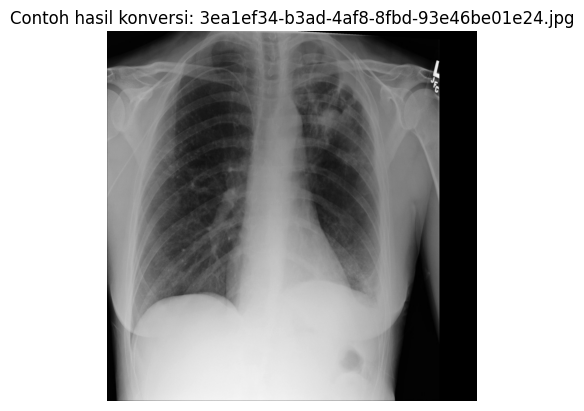

In [ ]:
import random
import matplotlib.pyplot as plt
import cv2

# Ambil 1 file JPG acak dari folder hasil
jpg_files = os.listdir(output_jpg_path)
sample_jpg = random.choice(jpg_files)

# Baca dan tampilkan
img = cv2.imread(os.path.join(output_jpg_path, sample_jpg))
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title(f"Contoh hasil konversi: {sample_jpg}")
plt.axis('off')
plt.show()


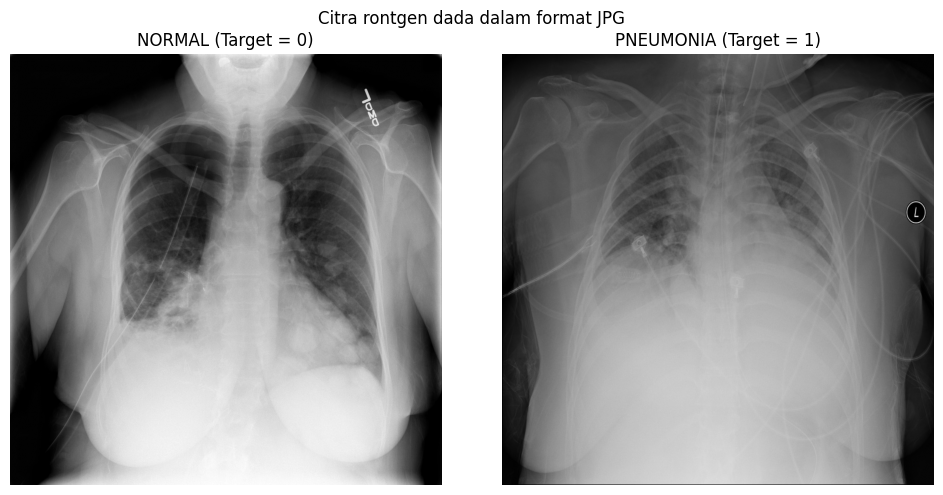

In [ ]:
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os

# Path
labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
img_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"

# Load label
df = pd.read_csv(labels_path)

# Ambil 1 contoh
normal_id = df[df['Target'] == 0]['patientId'].iloc[0]
pneumonia_id = df[df['Target'] == 1]['patientId'].iloc[0]

# Load gambar JPG
img_normal = cv2.imread(os.path.join(img_dir, normal_id + ".jpg"),
                         cv2.IMREAD_GRAYSCALE)
img_pneumonia = cv2.imread(os.path.join(img_dir, pneumonia_id + ".jpg"),
                            cv2.IMREAD_GRAYSCALE)

# Plot sampingan
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_normal, cmap="gray")
plt.title("NORMAL (Target = 0)")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_pneumonia, cmap="gray")
plt.title("PNEUMONIA (Target = 1)")
plt.axis("off")

# Keterangan format
plt.suptitle("Citra rontgen dada dalam format JPG", fontsize=12)

plt.tight_layout()
plt.show()


In [ ]:
#CLEANING DATA

In [9]:
import pandas as pd
import os

labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
dicom_dir = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_images"

df = pd.read_csv(labels_path)

# Jumlah file citra
dicom_files = [f.replace(".dcm", "") for f in os.listdir(dicom_dir) if f.endswith(".dcm")]

print("Jumlah file DICOM:", len(dicom_files))
print("Jumlah patientId unik di CSV:", df['patientId'].nunique())


Jumlah file DICOM: 26685
Jumlah patientId unik di CSV: 26684


In [10]:
dicom_set = set(dicom_files)
csv_set = set(df['patientId'].unique())

missing_in_csv = dicom_set - csv_set

print("Jumlah citra tanpa label:", len(missing_in_csv))
print("patientId tanpa label:", list(missing_in_csv)[:5])


Jumlah citra tanpa label: 1
patientId tanpa label: ['576f3fdc-8864-4709-b72f-a7b33fee8435 (1)']


In [11]:
import os

# Folder JPG asli
input_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"

# File tanpa label
file_sampah = "576f3fdc-8864-4709-b72f-a7b33fee8435 (1).jpg"

path_file = os.path.join(input_dir, file_sampah)

if os.path.exists(path_file):
    os.remove(path_file)
    print(f"🗑️ Berhasil menghapus: {file_sampah}")
else:
    print("File tidak ditemukan di folder JPG")


File tidak ditemukan di folder JPG


In [12]:
df_clean = df[df['patientId'].isin(dicom_set)]
print("Jumlah data setelah cleaning:", df_clean['patientId'].nunique())

Jumlah data setelah cleaning: 26684


In [14]:
import pandas as pd
import os

labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
dicom_dir = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_images"

df = pd.read_csv(labels_path)

print("Jumlah data awal:", len(df))


Jumlah data awal: 30227


In [15]:
unique_images = df['patientId'].nunique()
print("Jumlah gambar unik berdasarkan CSV:", unique_images)


Jumlah gambar unik berdasarkan CSV: 26684


In [16]:
normal_count = df[df['Target'] == 0]['patientId'].nunique()
pneumonia_count = df[df['Target'] == 1]['patientId'].nunique()

normal_count, pneumonia_count


(20672, 6012)

In [17]:
import pandas as pd

labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"

df = pd.read_csv(labels_path)


In [ ]:
#Tidak Bisa dilakukan karena butuh berhari hari dan komputasi yang besar
import os
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
from collections import Counter

# 1. Inisialisasi Folder
input_folder = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"
images = [f for f in os.listdir(input_folder) if f.endswith(".jpg")]

# 2. Rentang Parameter Sesuai Paper 2
# NT: 2, 4, ..., 24 (menggunakan 26 agar 24 terhitung)
nt_test = list(range(2, 26, 2))
# CL: 0.01, 0.02, ..., 1.00
cl_test = [round(i/100, 2) for i in range(1, 101)]

# List untuk menyimpan parameter 'Pemenang' dari SETIAP gambar
best_combinations_per_image = []

print(f"Memulai analisis Modified CLAHE pada seluruh dataset ({len(images)} gambar)...")

# Loop untuk SETIAP gambar dalam dataset
for filename in tqdm(images, desc="Menganalisis"):
    img_path = os.path.join(input_folder, filename)
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    if img is None: continue

    best_psnr = -1
    best_param = None

    # Brute-force mencari kombinasi terbaik untuk gambar tersebut
    for nt in nt_test:
        for cl in cl_test:
            clahe = cv2.createCLAHE(clipLimit=cl, tileGridSize=(nt, nt))
            enhanced = clahe.apply(img)

            # Hitung PSNR (Metrik Kualitas Paper 3)
            mse = np.mean((img - enhanced) ** 2)
            if mse == 0:
                psnr = 100
            else:
                psnr = 20 * np.log10(255.0 / np.sqrt(mse))

            # Cari nilai PSNR tertinggi
            if psnr > best_psnr:
                best_psnr = psnr
                best_param = (nt, cl)

    # Simpan parameter terbaik untuk gambar ini
    best_combinations_per_image.append(best_param)

# 3. KESIMPULAN AKHIR (General Parameter Selection - Paper 2)
# Menghitung parameter mana yang paling sering menang di seluruh dataset
conclusion_stats = Counter(best_combinations_per_image)
most_common_param, count = conclusion_stats.most_common(1)[0]

print("\n" + "="*50)
print("📊 HASIL AKHIR EVALUASI SELURUH DATASET")
print("="*50)
print(f"Total Gambar Dianalisis : {len(images)}")
print(f"Parameter NT Terpilih   : {most_common_param[0]}")
print(f"Parameter CL Terpilih   : {most_common_param[1]}")
print(f"Frekuensi Muncul        : {count} kali")
print("-" * 50)
print(f"✅ KESIMPULAN: Berdasarkan seluruh data, gunakan Grid {most_common_param[0]}x{most_common_param[0]} dan CL {most_common_param[1]}.")
print("="*50)

Memulai analisis Modified CLAHE pada seluruh dataset (26684 gambar)...


Menganalisis:   0%|          | 0/26684 [00:02<?, ?it/s]


KeyboardInterrupt: 

In [ ]:
#CLAHE PREPROCESSING PENINGKATAN KUALITAS CITRA
import cv2
import os
from concurrent.futures import ThreadPoolExecutor

input_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"
output_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_clahe"
os.makedirs(output_dir, exist_ok=True)

clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(8, 8))

def process_image(file_name):
    if not file_name.endswith(".jpg"):
        return

    output_path = os.path.join(output_dir, file_name)
    if os.path.exists(output_path):
        return  # sudah diproses

    img_path = os.path.join(input_dir, file_name)
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print("Gagal membaca:", file_name)
        return

    img_clahe = clahe.apply(img)
    cv2.imwrite(output_path, img_clahe)

jpg_files = os.listdir(input_dir)

with ThreadPoolExecutor(max_workers=4) as executor:
    executor.map(process_image, jpg_files)

print("CLAHE Standar selesai diproses untuk seluruh dataset")


KeyboardInterrupt: 

In [18]:
#MENAMPILKAN 1 GAMBAR CLAHE UNTUK DILIHAT GRIDENYA
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Baca gambar grayscale
img = cv2.imread("/content/sample_xray.jpg", cv2.IMREAD_GRAYSCALE)

# Terapkan CLAHE
clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(8,8))
clahe_img = clahe.apply(img)


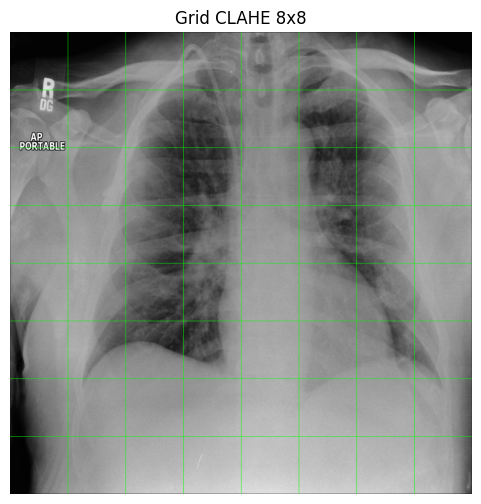

In [19]:
import cv2
import matplotlib.pyplot as plt

img_path = "/content/drive/MyDrive/RSNA_Pneumonia/train_clahe/002c591d-df62-4e34-8eda-838c664430a9.jpg"  # GANTI sesuai file kamu

img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

if img is None:
    raise ValueError("Gambar tidak ditemukan atau path salah")

h, w = img.shape
tile_h = h // 8
tile_w = w // 8

img_grid = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

for i in range(1, 8):
    cv2.line(img_grid, (0, i * tile_h), (w, i * tile_h), (0,255,0), 1)
    cv2.line(img_grid, (i * tile_w, 0), (i * tile_w, h), (0,255,0), 1)

plt.figure(figsize=(6,6))
plt.imshow(img_grid)
plt.title("Grid CLAHE 8x8")
plt.axis("off")
plt.show()


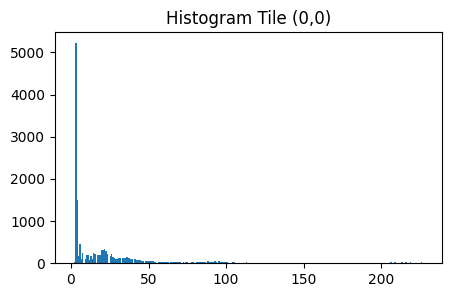

In [20]:
tile = img[0:tile_h, 0:tile_w]

plt.figure(figsize=(5,3))
plt.hist(tile.ravel(), bins=256)
plt.title("Histogram Tile (0,0)")
plt.show()


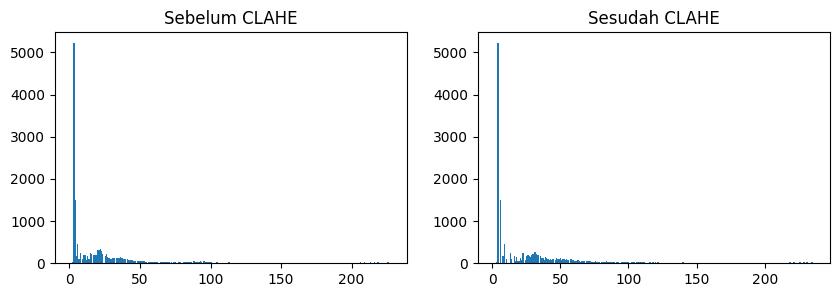

In [21]:
clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(8,8))
img_clahe = clahe.apply(img)

tile_clahe = img_clahe[0:tile_h, 0:tile_w]

plt.figure(figsize=(10,3))

plt.subplot(1,2,1)
plt.hist(tile.ravel(), bins=256)
plt.title("Sebelum CLAHE")

plt.subplot(1,2,2)
plt.hist(tile_clahe.ravel(), bins=256)
plt.title("Sesudah CLAHE")

plt.show()


In [20]:
import os
input_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"
output_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_clahe"

print("Jumlah JPG asli:", len(os.listdir(input_dir)))
print("Jumlah JPG CLAHE:", len(os.listdir(output_dir)))

Jumlah JPG asli: 26684
Jumlah JPG CLAHE: 26684


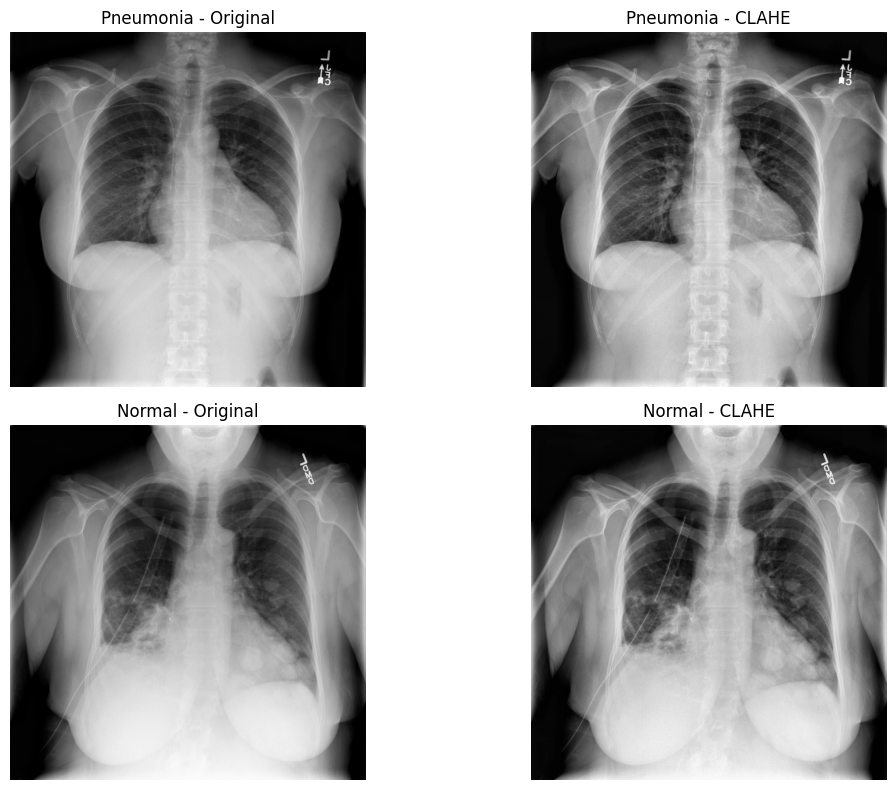

In [ ]:
#VISUALISASI PERBANDINGAN BEFORE AFTER CLAHE 2 KELAS TERSEBUT
import cv2
import matplotlib.pyplot as plt
import os
import pandas as pd

# Folder JPG asli dan hasil CLAHE
input_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"
clahe_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_clahe"

# CSV label
labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
df = pd.read_csv(labels_path)

# Ambil 1 contoh pneumonia dan 1 contoh normal
pid_pneumonia = df[df['Target'] == 1]['patientId'].unique()[5]
pid_normal = df[df['Target'] == 0]['patientId'].unique()[0]


# Baca gambar
img_pneumonia_orig = cv2.imread(os.path.join(input_dir, pid_pneumonia + ".jpg"), cv2.IMREAD_GRAYSCALE)
img_pneumonia_clahe = cv2.imread(os.path.join(clahe_dir, pid_pneumonia + ".jpg"), cv2.IMREAD_GRAYSCALE)

img_normal_orig = cv2.imread(os.path.join(input_dir, pid_normal + ".jpg"), cv2.IMREAD_GRAYSCALE)
img_normal_clahe = cv2.imread(os.path.join(clahe_dir, pid_normal + ".jpg"), cv2.IMREAD_GRAYSCALE)

# Visualisasi
plt.figure(figsize=(12, 8))

# Pneumonia
plt.subplot(2, 2, 1)
plt.imshow(img_pneumonia_orig, cmap='gray')
plt.title("Pneumonia - Original")
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(img_pneumonia_clahe, cmap='gray')
plt.title("Pneumonia - CLAHE")
plt.axis('off')

# Normal
plt.subplot(2, 2, 3)
plt.imshow(img_normal_orig, cmap='gray')
plt.title("Normal - Original")
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(img_normal_clahe, cmap='gray')
plt.title("Normal - CLAHE")
plt.axis('off')

plt.tight_layout()
plt.show()


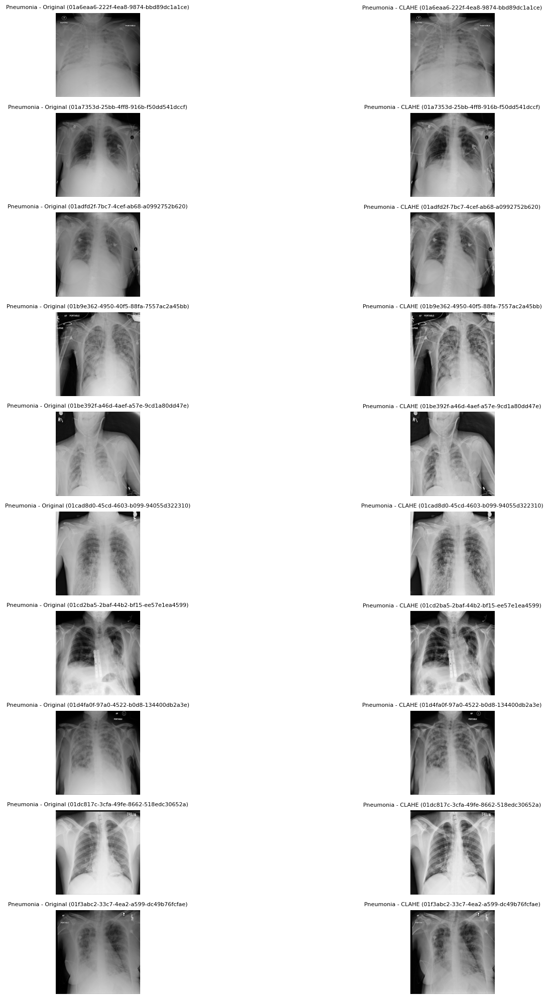

In [ ]:
import cv2
import matplotlib.pyplot as plt
import os
import pandas as pd

# Path
input_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_jpg"
clahe_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_clahe"
labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"

df = pd.read_csv(labels_path)

# Ambil 10 patient pneumonia
patient_ids = df[df['Target'] == 1]['patientId'].unique()[10:20]

plt.figure(figsize=(20, 20))

for i, pid in enumerate(patient_ids):
    img_orig = cv2.imread(os.path.join(input_dir, pid + ".jpg"), cv2.IMREAD_GRAYSCALE)
    img_clahe = cv2.imread(os.path.join(clahe_dir, pid + ".jpg"), cv2.IMREAD_GRAYSCALE)

    # Original
    plt.subplot(10, 2, 2*i + 1)
    plt.imshow(img_orig, cmap='gray')
    plt.title(f"Pneumonia - Original ({pid})", fontsize=8)
    plt.axis('off')

    # CLAHE
    plt.subplot(10, 2, 2*i + 2)
    plt.imshow(img_clahe, cmap='gray')
    plt.title(f"Pneumonia - CLAHE ({pid})", fontsize=8)
    plt.axis('off')

plt.tight_layout()
plt.show()


In [21]:
#SPLIT DATA

In [22]:
import pandas as pd

labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
df = pd.read_csv(labels_path)


In [23]:
df_pneumonia = df[df['Target'] == 1]
df_normal = df[df['Target'] == 0]


In [24]:
# Digunakan untuk training & validation (deteksi objek)
trainval_df = df_pneumonia.copy()

# Digunakan untuk testing (evaluasi)
test_df = df_normal.copy()


In [25]:
import pandas as pd

# Pastikan hanya data pneumonia (punya bounding box)
df_pneumonia = df[df['Target'] == 1]

# Hitung jumlah bounding box per patientId
bbox_per_patient = (
    df_pneumonia
    .groupby('patientId')
    .size()
    .reset_index(name='num_boxes')
)

# Hitung distribusi jumlah box
distribution = (
    bbox_per_patient
    .groupby('num_boxes')
    .size()
    .reset_index(name='num_images')
)

print(distribution)


   num_boxes  num_images
0          1        2614
1          2        3266
2          3         119
3          4          13


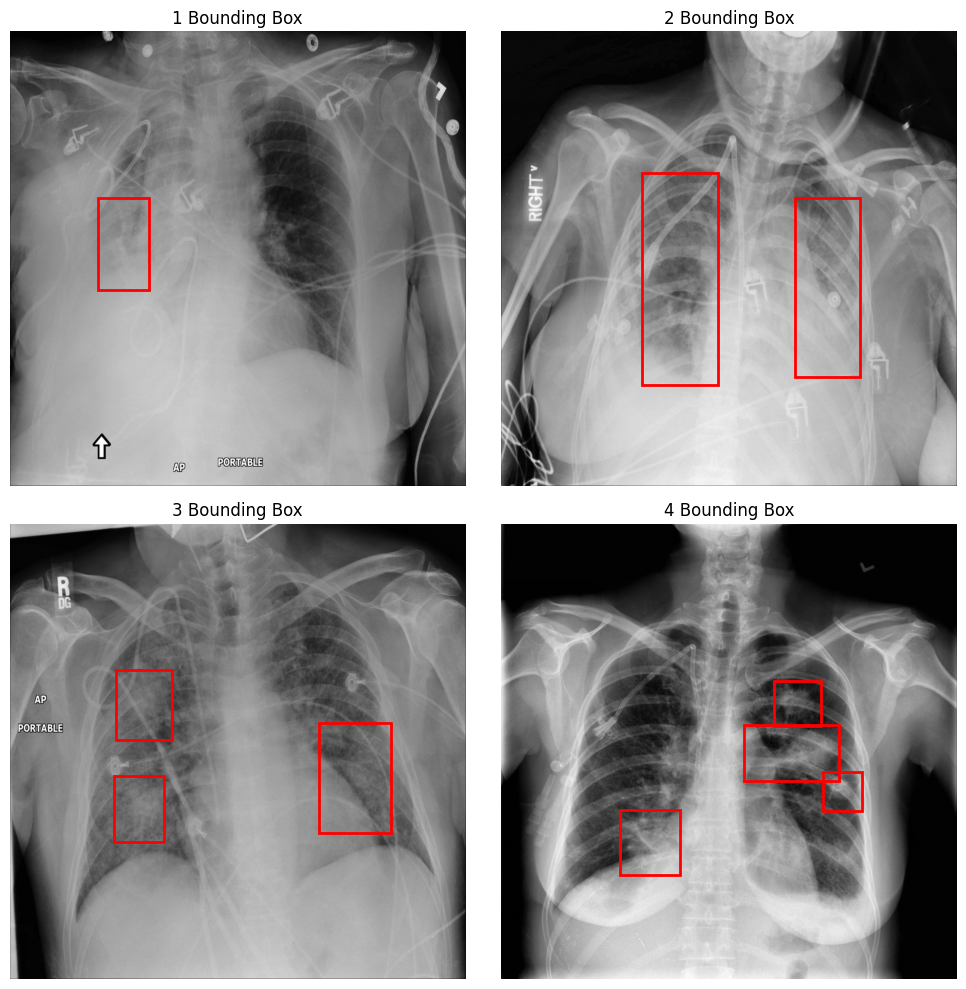

In [26]:
#MENAMPILKAN 4 JENIS BOUNDING BOX
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2
import os

# === PATH DATA ===
ANNOTATION_PATH = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
IMAGE_DIR = "/content/drive/MyDrive/RSNA_Pneumonia/train_clahe"

# === LOAD ANNOTATION ===
df = pd.read_csv(ANNOTATION_PATH)
df = df[df["Target"] == 1]

# Hitung jumlah bounding box per citra
bbox_count = df.groupby("patientId").size().reset_index(name="num_boxes")

# Ambil contoh citra dengan 1–4 bounding box
examples = {}
for n in [1, 2, 3, 4]:
    sample = bbox_count[bbox_count["num_boxes"] == n]
    if not sample.empty:
        examples[n] = sample.iloc[0]["patientId"]

# === VISUALISASI ===
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes = axes.flatten()

for idx, (num_boxes, patient_id) in enumerate(examples.items()):
    image_path = os.path.join(IMAGE_DIR, patient_id + ".jpg")
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    ax = axes[idx]
    ax.imshow(image, cmap="gray")
    ax.set_title(f"{num_boxes} Bounding Box")
    ax.axis("off")

    boxes = df[df["patientId"] == patient_id]
    for _, row in boxes.iterrows():
        rect = patches.Rectangle(
            (row["x"], row["y"]),
            row["width"],
            row["height"],
            linewidth=2,
            edgecolor="red",
            facecolor="none"
        )
        ax.add_patch(rect)

plt.tight_layout()
plt.show()


In [26]:
#DATAFRAME SPLIT DATA
from sklearn.model_selection import train_test_split
import pandas as pd

labels_path = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
df = pd.read_csv(labels_path)

df_pneumonia = df[df['Target'] == 1]
bbox_count_df = (
    df_pneumonia
    .groupby('patientId')
    .size()
    .reset_index(name='num_boxes')
)

patient_df = bbox_count_df.copy()
train_patients, temp_patients = train_test_split(
    patient_df,
    test_size=0.2,
    stratify=patient_df['num_boxes'],
    random_state=42
)

val_patients, test_patients = train_test_split(
    temp_patients,
    test_size=0.5,
    stratify=temp_patients['num_boxes'],
    random_state=42
)

train_df = df_pneumonia[df_pneumonia['patientId'].isin(train_patients['patientId'])]
val_df   = df_pneumonia[df_pneumonia['patientId'].isin(val_patients['patientId'])]
test_df  = df_pneumonia[df_pneumonia['patientId'].isin(test_patients['patientId'])]

print(train_df['patientId'].nunique(),
      val_df['patientId'].nunique(),
      test_df['patientId'].nunique())

4809 601 602


In [27]:
#SPLIT DATA
import shutil
import os

clahe_dir = "/content/drive/MyDrive/RSNA_Pneumonia/train_clahe"
base_out = "/content/clahe_split"

train_out = os.path.join(base_out, "train")
val_out   = os.path.join(base_out, "val")
test_out  = os.path.join(base_out, "test")

os.makedirs(train_out, exist_ok=True)
os.makedirs(val_out, exist_ok=True)
os.makedirs(test_out, exist_ok=True)

train_ids = set(train_df['patientId'])
val_ids   = set(val_df['patientId'])
test_ids  = set(test_df['patientId'])

for file in os.listdir(clahe_dir):
    if not file.endswith(".jpg"):
        continue

    pid = file.replace(".jpg", "")

    src = os.path.join(clahe_dir, file)

    if pid in train_ids:
        shutil.copy(src, os.path.join(train_out, file))
    elif pid in val_ids:
        shutil.copy(src, os.path.join(val_out, file))
    elif pid in test_ids:
        shutil.copy(src, os.path.join(test_out, file))


In [28]:
import pandas as pd

def check_bbox_distribution(df_subset, subset_name):
    bbox_count = (
        df_subset
        .groupby('patientId')
        .size()
        .reset_index(name='num_boxes')
        .groupby('num_boxes')
        .size()
        .reset_index(name='num_patients')
    )

    print(f"\nDistribusi bounding box pada {subset_name}:")
    print(bbox_count)

# Cek distribusi di masing-masing subset
check_bbox_distribution(train_df, "Training Set")
check_bbox_distribution(val_df, "Validation Set")
check_bbox_distribution(test_df, "Test Set")



Distribusi bounding box pada Training Set:
   num_boxes  num_patients
0          1          2091
1          2          2613
2          3            95
3          4            10

Distribusi bounding box pada Validation Set:
   num_boxes  num_patients
0          1           261
1          2           326
2          3            12
3          4             2

Distribusi bounding box pada Test Set:
   num_boxes  num_patients
0          1           262
1          2           327
2          3            12
3          4             1


In [ ]:
#AUGMENTASI

In [29]:
# AUGMENTASI DATA (SETELAH SPLIT, HANYA TRAIN)
import cv2
import os

# Folder TRAIN hasil split CLAHE
train_dir = "/content/clahe_split/train"

# Folder output augmentasi
aug_dir = "/content/train_aug"
os.makedirs(aug_dir, exist_ok=True)

for file_name in os.listdir(train_dir):
    if not file_name.endswith(".jpg"):
        continue

    img_path = os.path.join(train_dir, file_name)
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    if img is None:
        continue

    base_name = file_name.replace(".jpg", "")

    # Horizontal flip
    img_hflip = cv2.flip(img, 1)

    # Vertical flip
    img_vflip = cv2.flip(img, 0)

    # Simpan hasil augmentasi
    cv2.imwrite(os.path.join(aug_dir, f"{base_name}_hflip.jpg"), img_hflip)
    cv2.imwrite(os.path.join(aug_dir, f"{base_name}_vflip.jpg"), img_vflip)

print("Augmentasi data TRAIN selesai (horizontal & vertical flipping).")


Augmentasi data TRAIN selesai (horizontal & vertical flipping).


In [30]:
#FLIP ANOTASI BOUNDING BOX DI FILE CSVNYA
import torch
from torch.utils.data import Dataset
import cv2
import os

class RSNADataset(Dataset):
    def __init__(self, df, img_dir):
        self.df = df
        self.img_dir = img_dir
        self.files = [f for f in os.listdir(img_dir) if f.endswith(".jpg")]

    def __len__(self):
        return len(self.files)
    def __getitem__(self, idx):
        file = self.files[idx]

        # Deteksi jenis augmentasi dari nama file
        is_hflip = "_hflip" in file
        is_vflip = "_vflip" in file

        pid = file.replace(".jpg","").replace("_hflip","").replace("_vflip","")

        # Load image (sudah ter-flip)
        img = cv2.imread(os.path.join(self.img_dir, file), 0)
        h, w = img.shape
        img = torch.tensor(img).float().unsqueeze(0) / 255.0

        # Load bounding box dari CSV (asli)
        rows = self.df[self.df.patientId == pid]
        boxes = rows[['x','y','width','height']].values
        boxes[:,2] += boxes[:,0]  # x_max
        boxes[:,3] += boxes[:,1]  # y_max

        # Horizontal flip bbox
        if is_hflip:
            x_min = boxes[:,0].copy()
            x_max = boxes[:,2].copy()
            boxes[:,0] = w - x_max
            boxes[:,2] = w - x_min

        # Vertical flip bbox
        if is_vflip:
            y_min = boxes[:,1].copy()
            y_max = boxes[:,3].copy()
            boxes[:,1] = h - y_max
            boxes[:,3] = h - y_min

        target = {
            "boxes": torch.tensor(boxes).float(),
            "labels": torch.ones(len(boxes), dtype=torch.int64)
        }

        return img, target


In [31]:
#Menambahkan citra ori ke folder yang sama dengan augmentasinya
import os
import shutil

train_clahe_dir = "/content/clahe_split/train"
train_aug_dir   = "/content/train_aug"

os.makedirs(train_aug_dir, exist_ok=True)

for file in os.listdir(train_clahe_dir):
    if file.endswith(".jpg"):
        shutil.copy(
            os.path.join(train_clahe_dir, file),
            os.path.join(train_aug_dir, file)
        )

print("✅ Citra TRAIN asli (CLAHE) berhasil disalin ke folder train_aug")


✅ Citra TRAIN asli (CLAHE) berhasil disalin ke folder train_aug


In [32]:
import os

aug_dir = "/content/train_aug"

jumlah_aug = len([f for f in os.listdir(aug_dir) if f.endswith(".jpg")])

print("Jumlah citra hasil augmentasi:", jumlah_aug)

Jumlah citra hasil augmentasi: 14427


In [33]:
#Jumlah Data Yang Akan di Training Setelah Augmentasi Flip vertikal dan Horizontal
import os

aug_dir = "/content/train_aug"

ori = len([
    f for f in os.listdir(aug_dir)
    if f.endswith(".jpg") and "_hflip" not in f and "_vflip" not in f
])

hflip = len([f for f in os.listdir(aug_dir) if "_hflip" in f])
vflip = len([f for f in os.listdir(aug_dir) if "_vflip" in f])

print("Jumlah citra asli (ORI)       :", ori)
print("Jumlah citra horizontal flip :", hflip)
print("Jumlah citra vertical flip   :", vflip)
print("Jumlah seluruh citra TRAIN   :", ori + hflip + vflip)

Jumlah citra asli (ORI)       : 4809
Jumlah citra horizontal flip : 4809
Jumlah citra vertical flip   : 4809
Jumlah seluruh citra TRAIN   : 14427


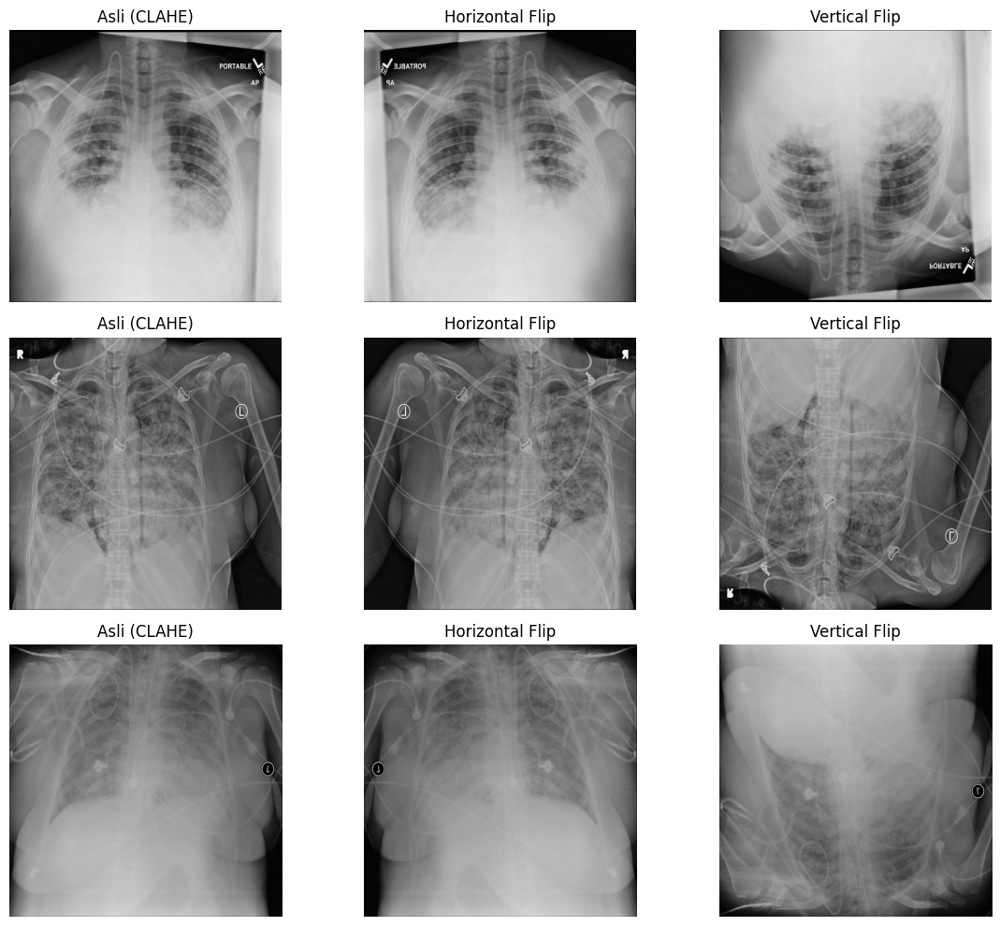

In [ ]:
#MENAMPILKAN CONTOH AUGMENTASI YANG DILAKUKAN
import os
import cv2
import matplotlib.pyplot as plt

aug_dir = "/content/train_aug"

# Ambil 3 file ORI (tanpa suffix)
ori_files = [
    f for f in os.listdir(aug_dir)
    if f.endswith(".jpg") and "_hflip" not in f and "_vflip" not in f
][:3]

fig, axes = plt.subplots(3, 3, figsize=(12, 10))

for i, ori_file in enumerate(ori_files):
    base = ori_file.replace(".jpg", "")

    ori = cv2.imread(os.path.join(aug_dir, ori_file), cv2.IMREAD_GRAYSCALE)
    h   = cv2.imread(os.path.join(aug_dir, f"{base}_hflip.jpg"), cv2.IMREAD_GRAYSCALE)
    v   = cv2.imread(os.path.join(aug_dir, f"{base}_vflip.jpg"), cv2.IMREAD_GRAYSCALE)

    axes[i, 0].imshow(ori, cmap="gray")
    axes[i, 0].set_title("Asli (CLAHE)")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(h, cmap="gray")
    axes[i, 1].set_title("Horizontal Flip")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(v, cmap="gray")
    axes[i, 2].set_title("Vertical Flip")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()


Patient ID: b402960f-5989-4469-941e-b8dee9ff6275 | File: b402960f-5989-4469-941e-b8dee9ff6275_vflip.jpg


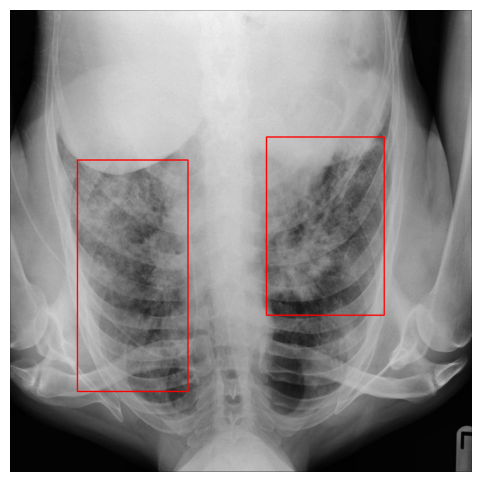

Patient ID: d73404b9-b882-4d8f-a14f-876aa52c9559 | File: d73404b9-b882-4d8f-a14f-876aa52c9559.jpg


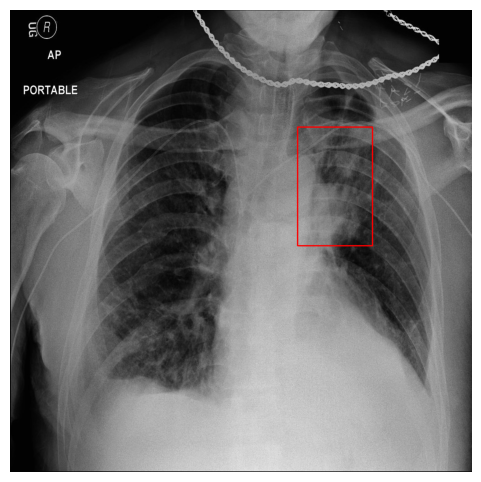

Patient ID: 00c0b293-48e7-4e16-ac76-9269ba535a62 | File: 00c0b293-48e7-4e16-ac76-9269ba535a62.jpg


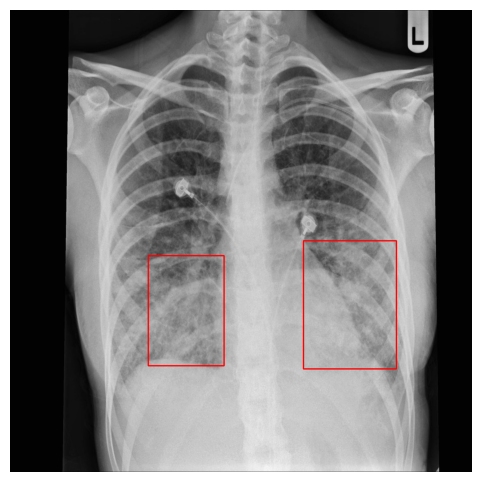

Patient ID: 70a630f3-c0cd-4487-b07f-87e2bbe961e0 | File: 70a630f3-c0cd-4487-b07f-87e2bbe961e0.jpg


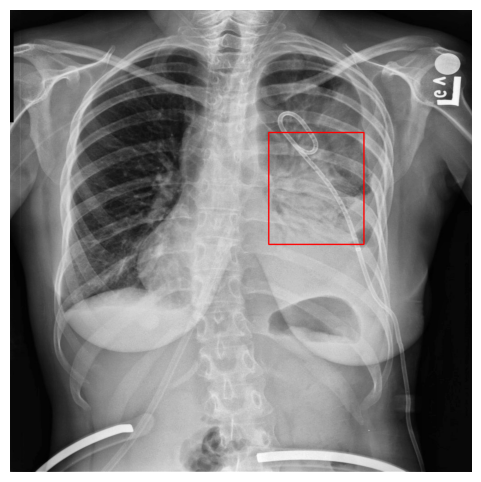

Patient ID: a03a2aab-7039-4743-9dab-3870899b1f35 | File: a03a2aab-7039-4743-9dab-3870899b1f35.jpg


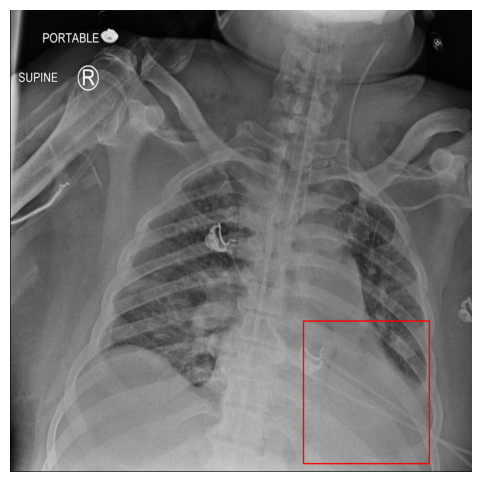

Patient ID: a5df1553-7c85-46e6-9e0b-870d67d23eb7 | File: a5df1553-7c85-46e6-9e0b-870d67d23eb7_vflip.jpg


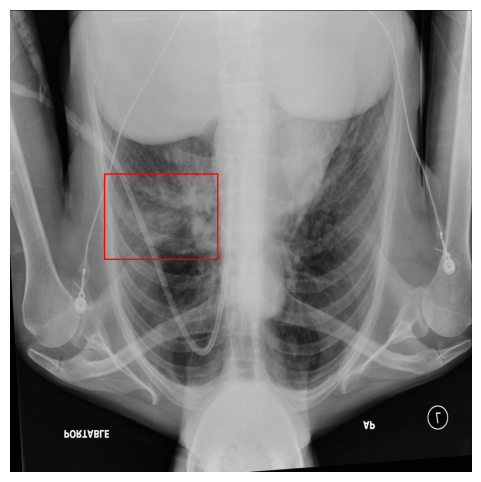

Patient ID: b329ead1-3d20-43af-b0d9-bc4e98ec2239 | File: b329ead1-3d20-43af-b0d9-bc4e98ec2239_vflip.jpg


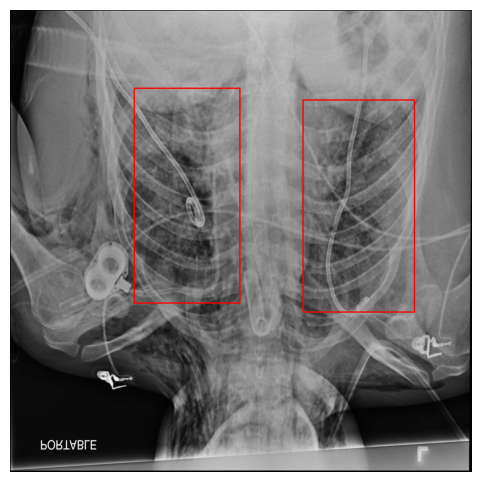

Patient ID: 805a1fbb-fea5-4d9f-8d1d-3bc372e1b24c | File: 805a1fbb-fea5-4d9f-8d1d-3bc372e1b24c.jpg


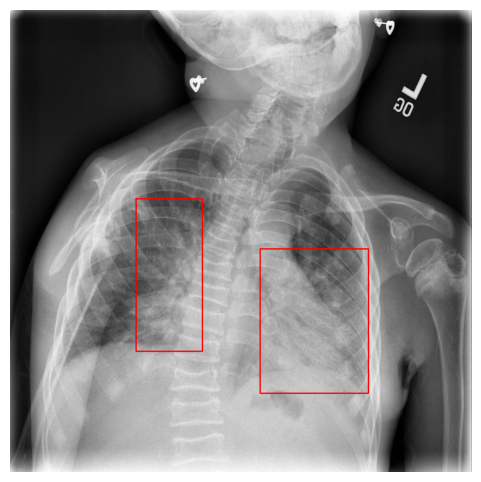

Patient ID: 5415656d-d814-46c2-a8c7-ab2831c42a91 | File: 5415656d-d814-46c2-a8c7-ab2831c42a91_vflip.jpg


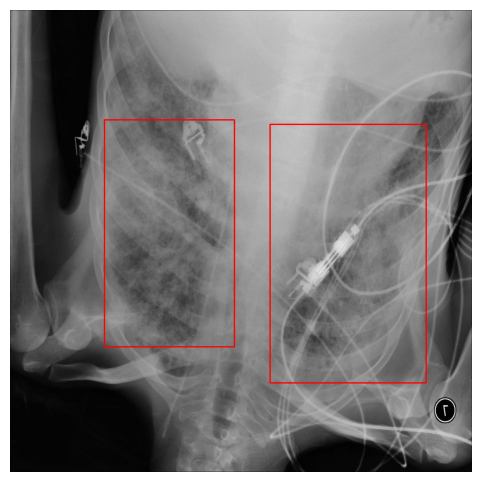

Patient ID: cbf72626-2c8e-4d1d-91a7-4afcb413674e | File: cbf72626-2c8e-4d1d-91a7-4afcb413674e_hflip.jpg


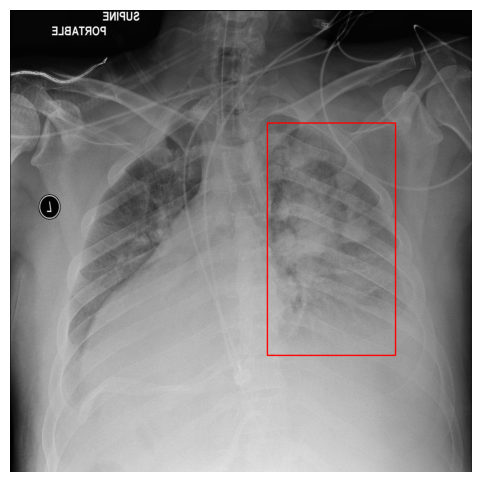

Patient ID: 94399962-8f89-4dfa-a93f-7a3df88feca5 | File: 94399962-8f89-4dfa-a93f-7a3df88feca5_vflip.jpg


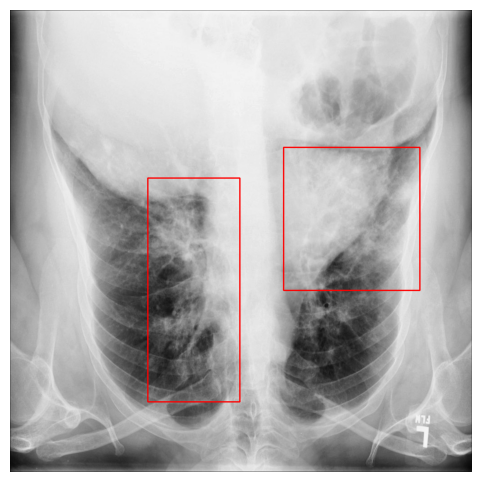

Patient ID: ba1649bf-15b7-46ba-b841-7aeb71f9e4c6 | File: ba1649bf-15b7-46ba-b841-7aeb71f9e4c6.jpg


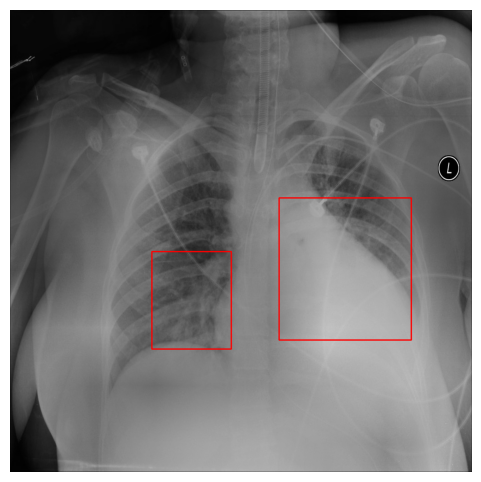

Patient ID: e6a3f420-39d4-4042-8485-87024e7fb4f3 | File: e6a3f420-39d4-4042-8485-87024e7fb4f3_vflip.jpg


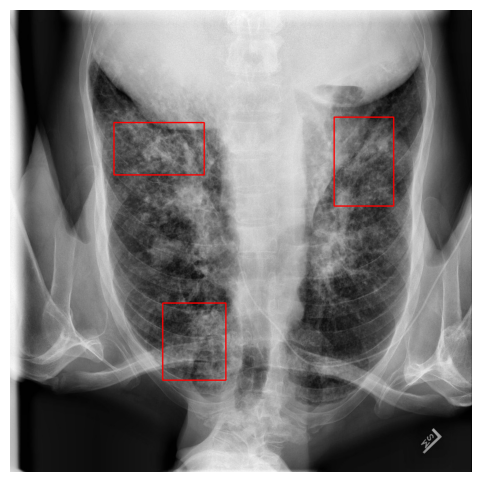

Patient ID: 389628be-67a0-4854-a44e-0c4e2df93b04 | File: 389628be-67a0-4854-a44e-0c4e2df93b04_vflip.jpg


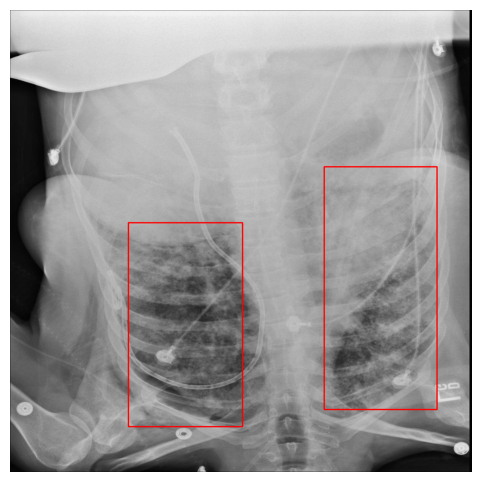

Patient ID: 25310577-2bea-495f-b73c-7eff7954571e | File: 25310577-2bea-495f-b73c-7eff7954571e_hflip.jpg


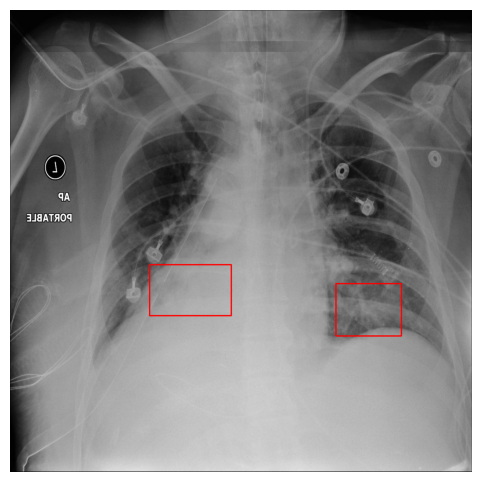

Patient ID: dc7720ba-e9fe-4680-8304-bb149bedf128 | File: dc7720ba-e9fe-4680-8304-bb149bedf128_vflip.jpg


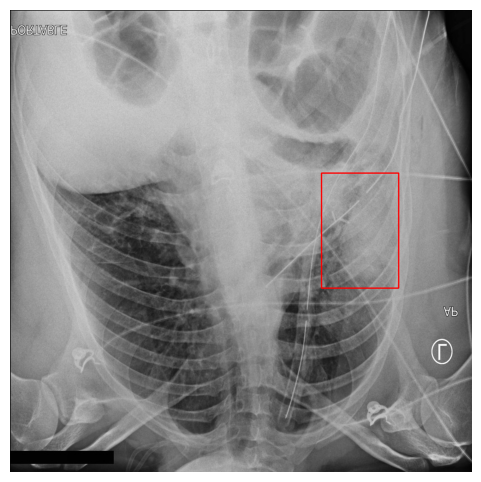

Patient ID: 7e4e7293-a984-462e-8d9f-c7a30863dae2 | File: 7e4e7293-a984-462e-8d9f-c7a30863dae2_hflip.jpg


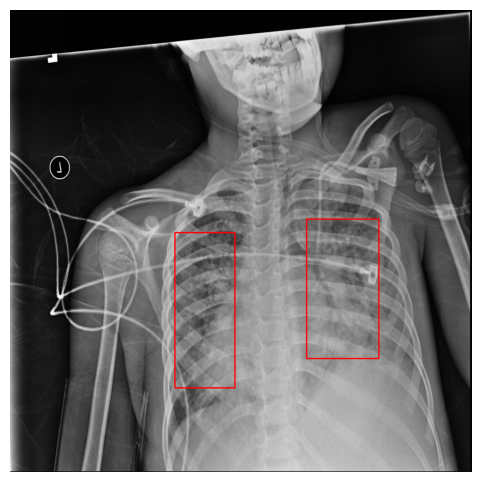

Patient ID: 5ca1b422-48da-4b44-b98e-152ea6f5f25a | File: 5ca1b422-48da-4b44-b98e-152ea6f5f25a_vflip.jpg


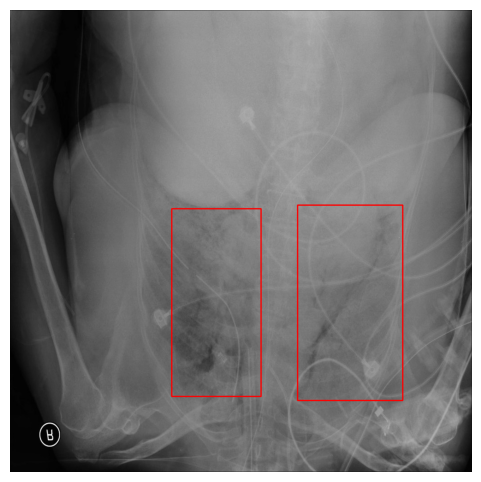

Patient ID: 5f8240fa-94df-47ed-8f8c-3eca1f92bc28 | File: 5f8240fa-94df-47ed-8f8c-3eca1f92bc28_vflip.jpg


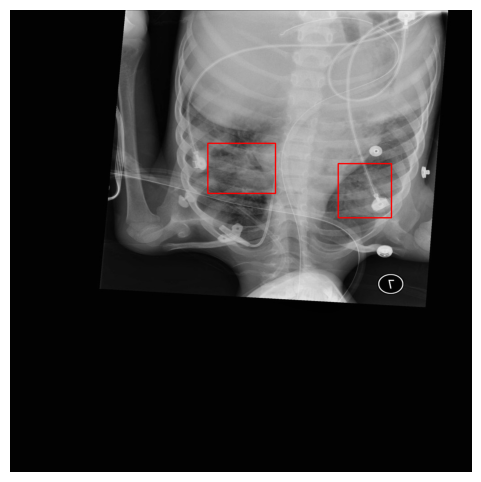

Patient ID: 904070bc-c210-47ef-b886-abb6b0dd7ee3 | File: 904070bc-c210-47ef-b886-abb6b0dd7ee3_vflip.jpg


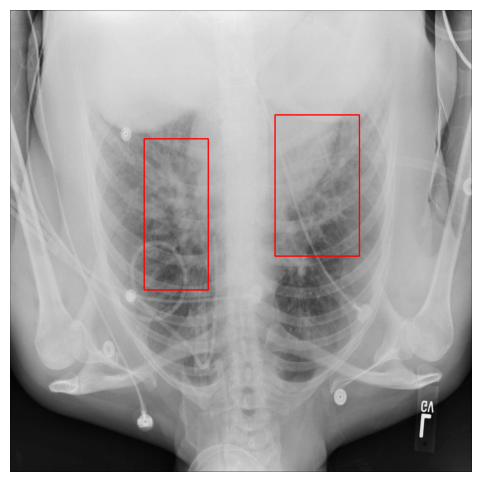

Patient ID: 65f61ec4-b763-4d94-93ef-135e22717e12 | File: 65f61ec4-b763-4d94-93ef-135e22717e12_hflip.jpg


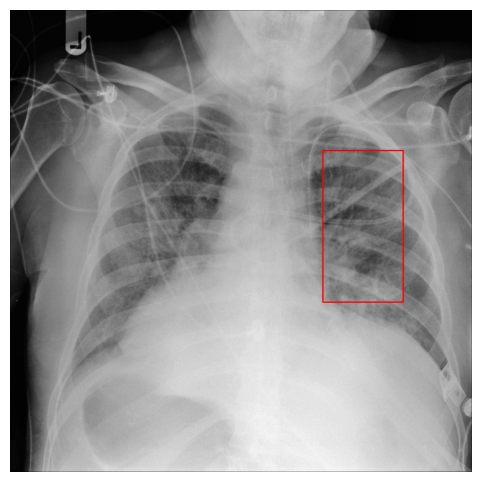

Patient ID: 9ebc1edb-315f-4f0f-bc9b-dfa933bc67d3 | File: 9ebc1edb-315f-4f0f-bc9b-dfa933bc67d3.jpg


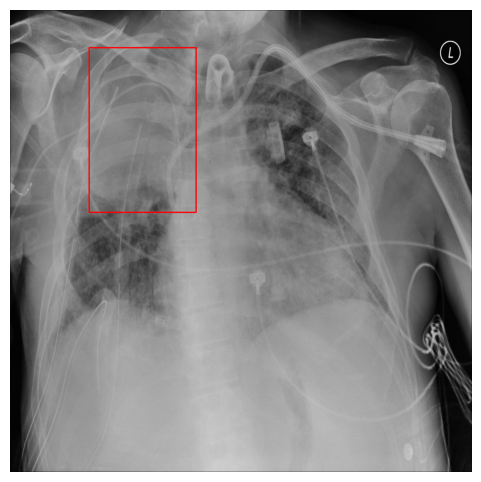

Patient ID: 816cef8f-cbf7-43c7-8386-609bd95c78e6 | File: 816cef8f-cbf7-43c7-8386-609bd95c78e6_vflip.jpg


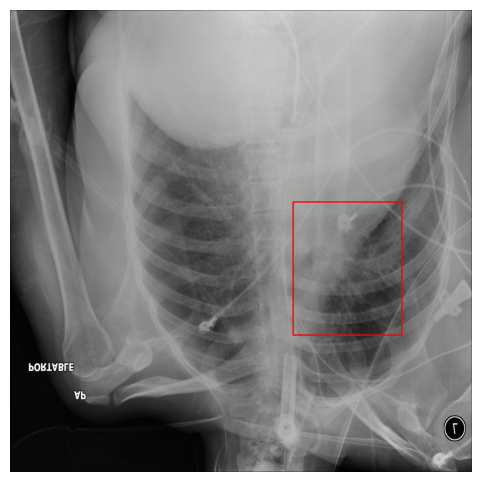

Patient ID: b7d0cb5e-5594-41f1-9426-c7aa2cfd945c | File: b7d0cb5e-5594-41f1-9426-c7aa2cfd945c_hflip.jpg


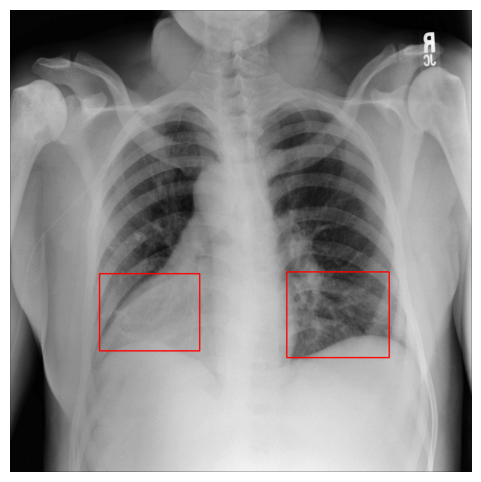

Patient ID: 07d1a89d-351c-4a75-993a-ba315142b419 | File: 07d1a89d-351c-4a75-993a-ba315142b419_vflip.jpg


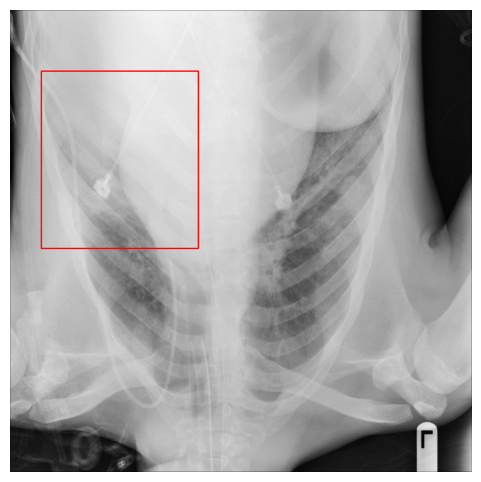

Patient ID: b4ae5b1d-2d5e-422a-9388-36f4645d21c7 | File: b4ae5b1d-2d5e-422a-9388-36f4645d21c7_vflip.jpg


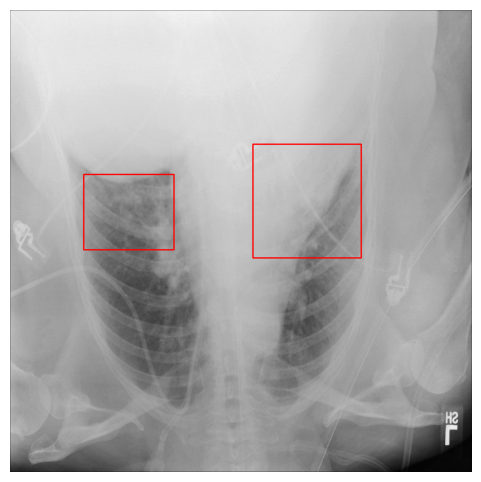

Patient ID: 1101cedc-35e2-483c-9326-1f3232b88f06 | File: 1101cedc-35e2-483c-9326-1f3232b88f06_vflip.jpg


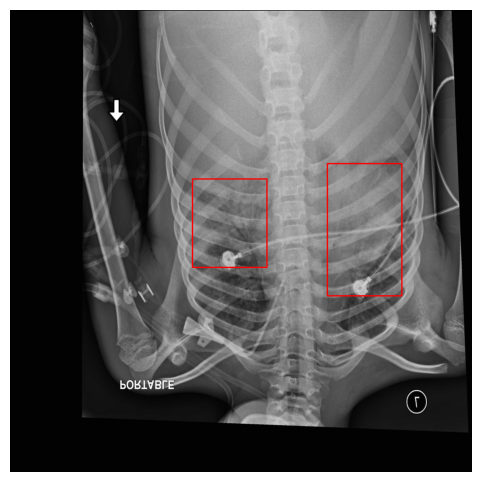

Patient ID: b0d34352-21d3-490e-8ecd-16baee334aba | File: b0d34352-21d3-490e-8ecd-16baee334aba_hflip.jpg


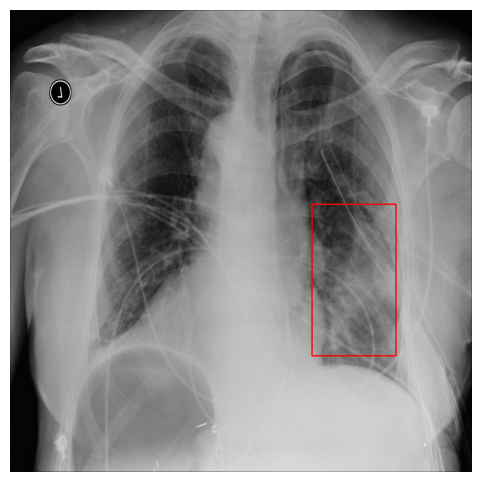

Patient ID: d667579e-aa2d-461e-a869-4799ad466add | File: d667579e-aa2d-461e-a869-4799ad466add_hflip.jpg


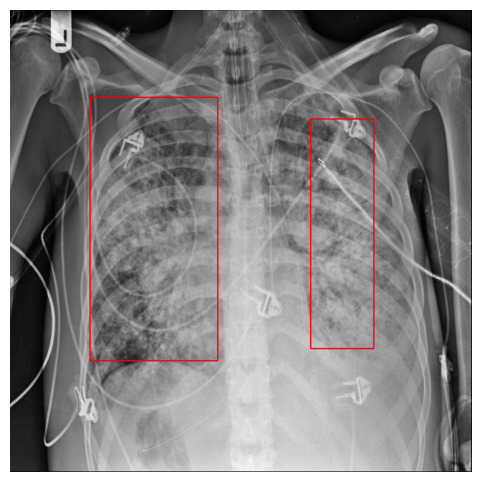

Patient ID: 74d04109-2cd0-497f-a3d3-b04fcbd34b10 | File: 74d04109-2cd0-497f-a3d3-b04fcbd34b10.jpg


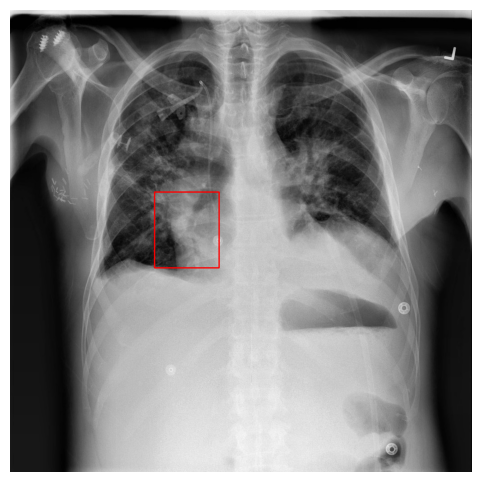

Patient ID: 254f04d1-d24e-43bc-a00d-8f7140c222fb | File: 254f04d1-d24e-43bc-a00d-8f7140c222fb.jpg


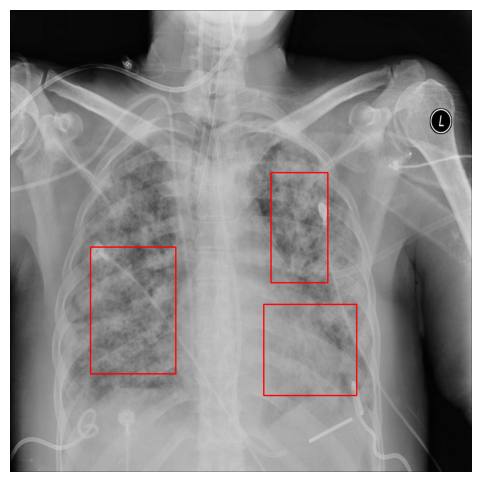

Patient ID: a6cbb3dd-75ab-4671-a6b0-9a51c04a81ec | File: a6cbb3dd-75ab-4671-a6b0-9a51c04a81ec_vflip.jpg


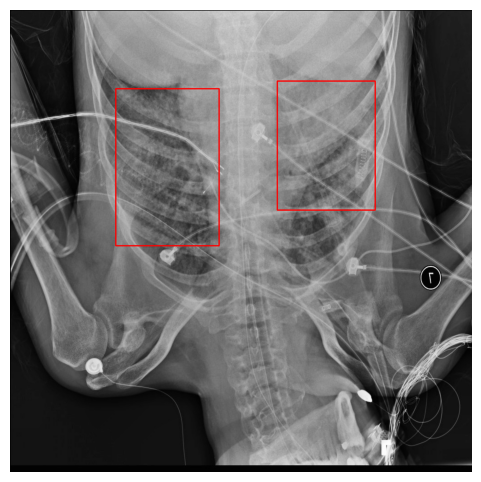

Patient ID: 73247e1a-000f-4d41-825f-c8a0d2162007 | File: 73247e1a-000f-4d41-825f-c8a0d2162007_hflip.jpg


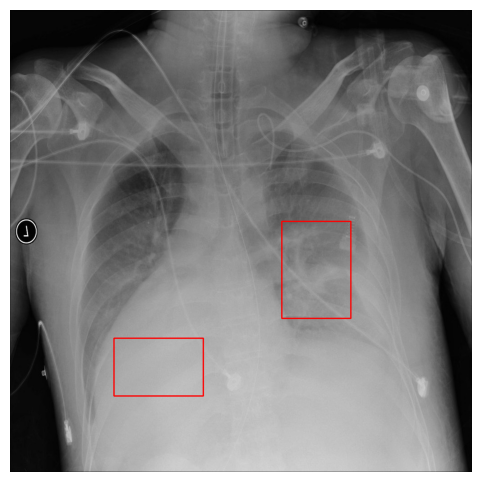

Patient ID: 92d7540d-db17-4fa8-814a-3d719157928c | File: 92d7540d-db17-4fa8-814a-3d719157928c_hflip.jpg


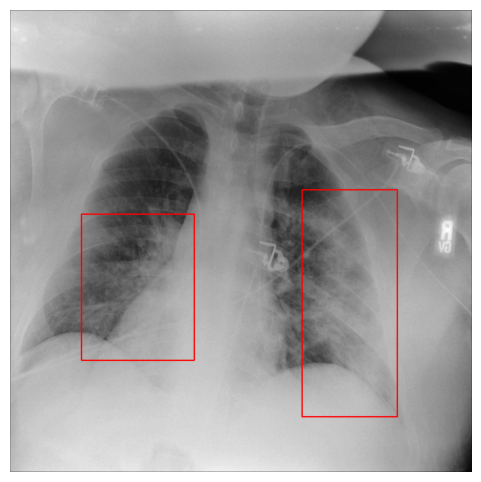

Patient ID: 826361cd-08ae-49c4-b535-25a4f14026f8 | File: 826361cd-08ae-49c4-b535-25a4f14026f8.jpg


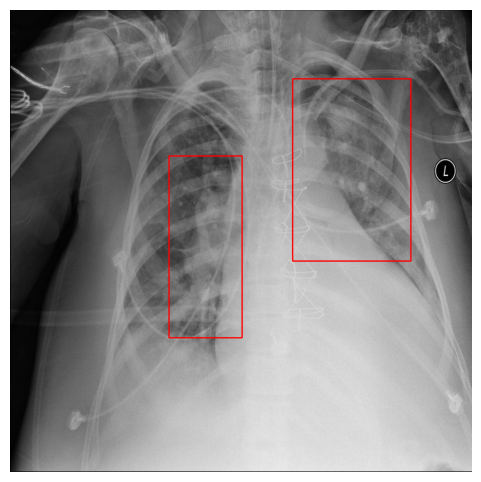

Patient ID: 05632b7f-f4c5-4d67-aa93-8f3c04eb7937 | File: 05632b7f-f4c5-4d67-aa93-8f3c04eb7937.jpg


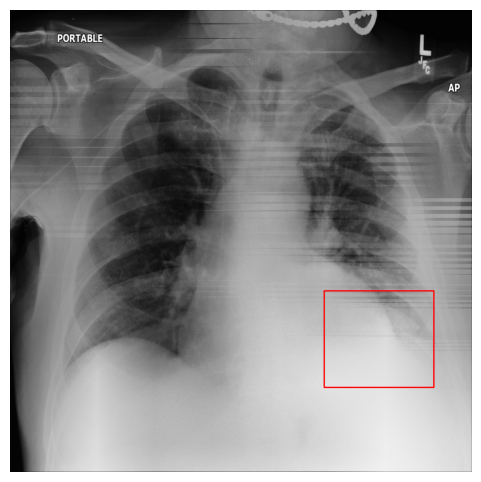

Patient ID: 7c909599-24ad-4164-93d2-0adfa96ec86f | File: 7c909599-24ad-4164-93d2-0adfa96ec86f_hflip.jpg


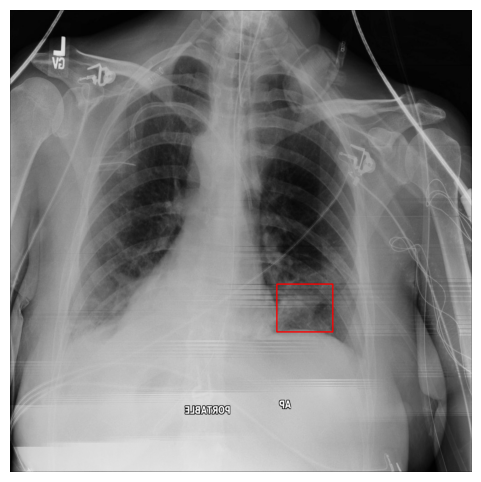

Patient ID: 3bb338a0-7e3d-4248-8731-a8daffa15e58 | File: 3bb338a0-7e3d-4248-8731-a8daffa15e58.jpg


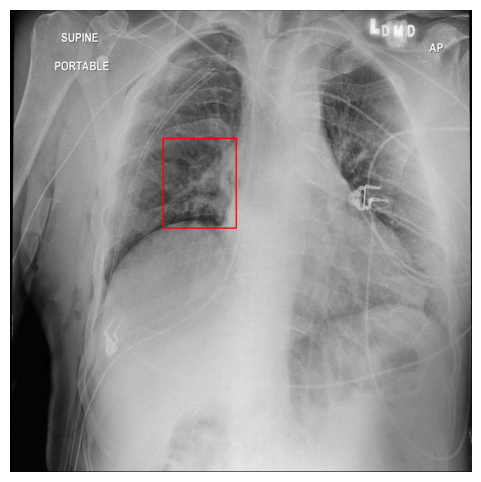

Patient ID: eb211810-c51d-42c7-913b-d327c8ca4dd7 | File: eb211810-c51d-42c7-913b-d327c8ca4dd7.jpg


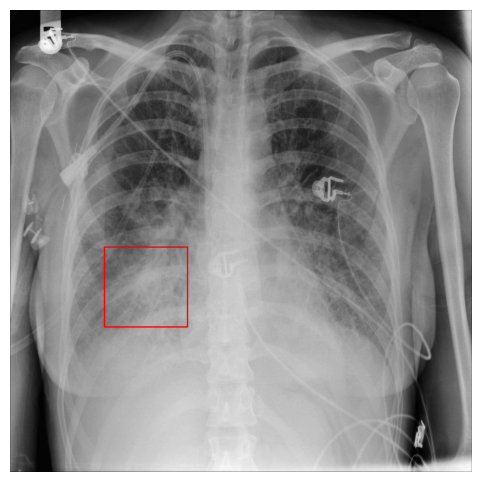

Patient ID: 7c086e53-4bad-4bc6-9ff6-292614b69e07 | File: 7c086e53-4bad-4bc6-9ff6-292614b69e07_hflip.jpg


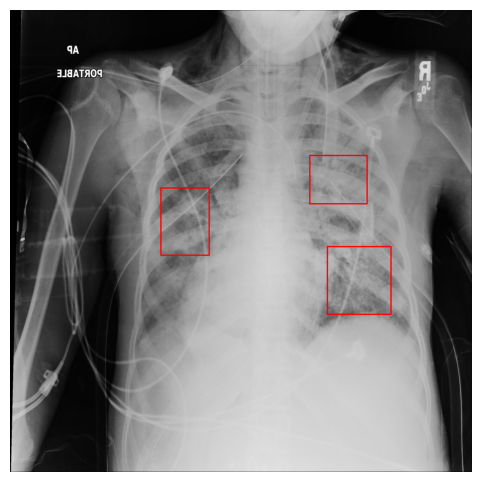

Patient ID: 2a15b6f2-2a17-454d-b14c-ba1bb4bd79f4 | File: 2a15b6f2-2a17-454d-b14c-ba1bb4bd79f4_hflip.jpg


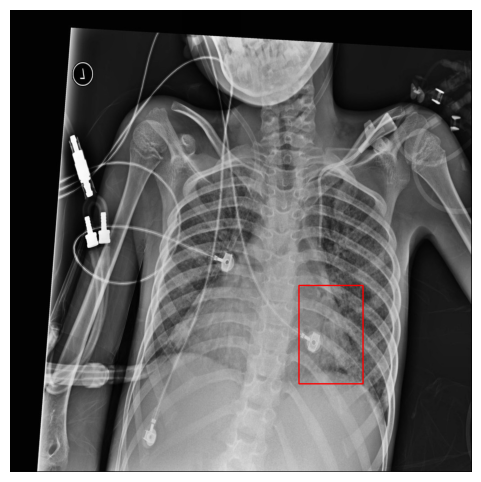

Patient ID: eb2f6354-73d5-47f8-b40c-72579eeec569 | File: eb2f6354-73d5-47f8-b40c-72579eeec569.jpg


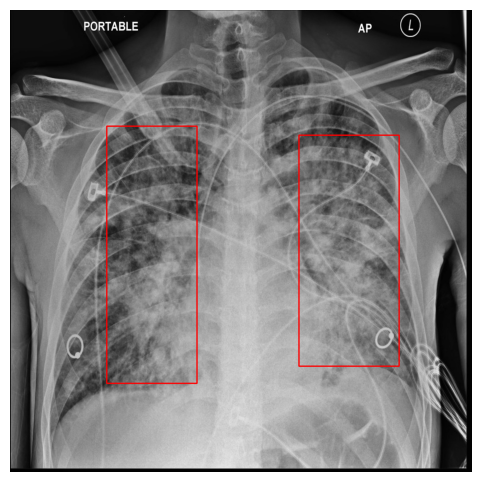

Patient ID: b86479a1-e997-4026-acfc-2d467291eb50 | File: b86479a1-e997-4026-acfc-2d467291eb50_hflip.jpg


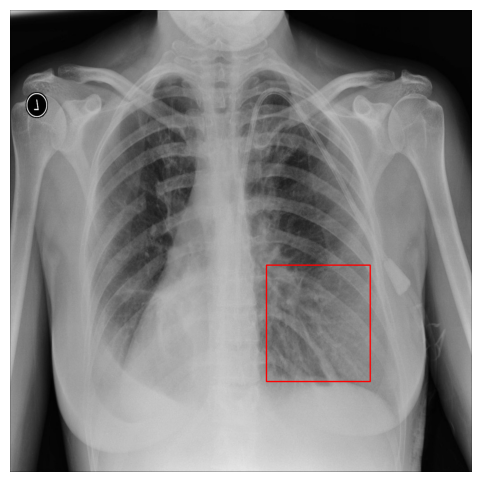

Patient ID: 28a2d8aa-9e29-48d4-b1e3-029e3451ce0b | File: 28a2d8aa-9e29-48d4-b1e3-029e3451ce0b.jpg


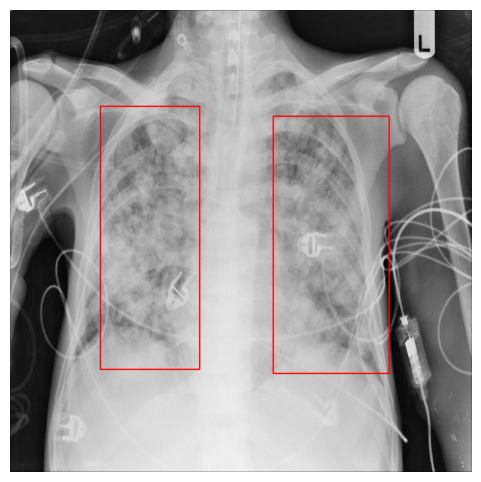

Patient ID: b2f5b10a-917c-4080-8046-ec1c9fb9cb39 | File: b2f5b10a-917c-4080-8046-ec1c9fb9cb39_hflip.jpg


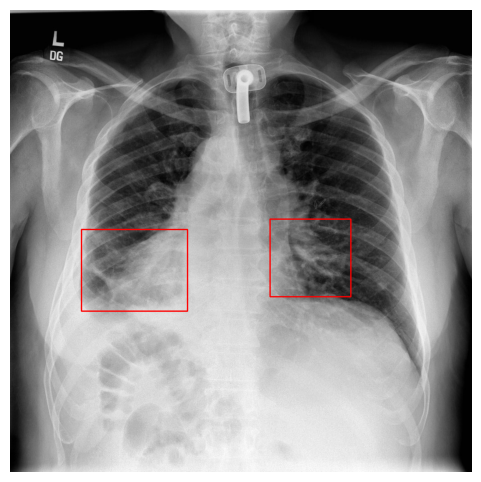

Patient ID: 205f5b04-b42a-4890-af36-0ed2de7a56a1 | File: 205f5b04-b42a-4890-af36-0ed2de7a56a1_vflip.jpg


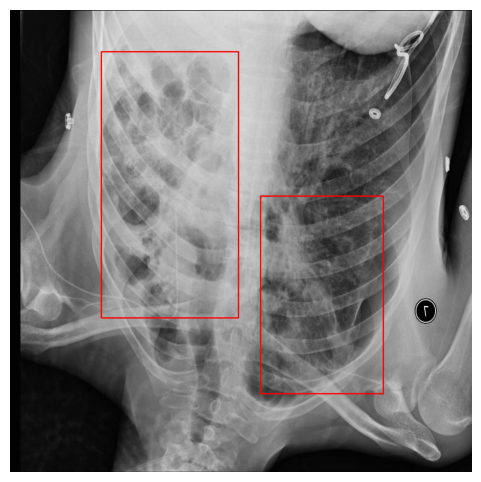

Patient ID: f0646657-7174-461b-9ab4-07242c759384 | File: f0646657-7174-461b-9ab4-07242c759384_vflip.jpg


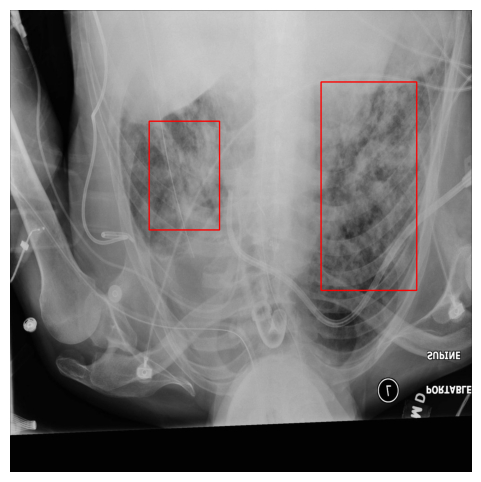

Patient ID: 9388011e-2250-40d3-be0e-39bc418d984b | File: 9388011e-2250-40d3-be0e-39bc418d984b_vflip.jpg


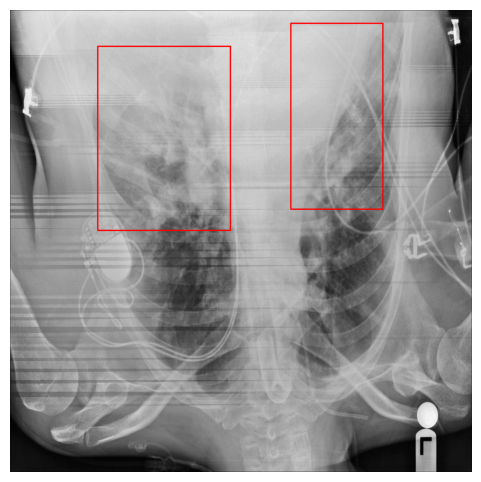

Patient ID: 9f1ab54d-5fb8-4464-9617-26a7d25f26cd | File: 9f1ab54d-5fb8-4464-9617-26a7d25f26cd.jpg


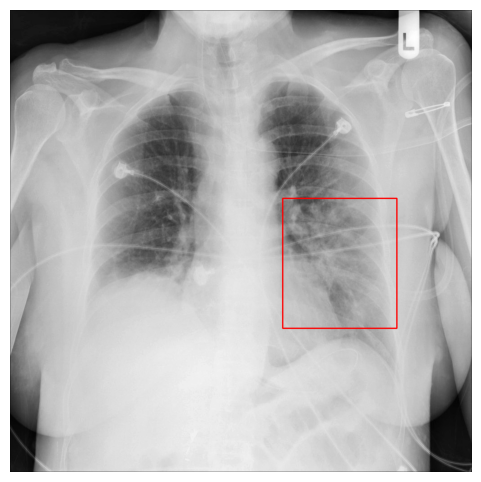

Patient ID: 2b57dc05-b925-4d58-b536-c9eae9677d05 | File: 2b57dc05-b925-4d58-b536-c9eae9677d05.jpg


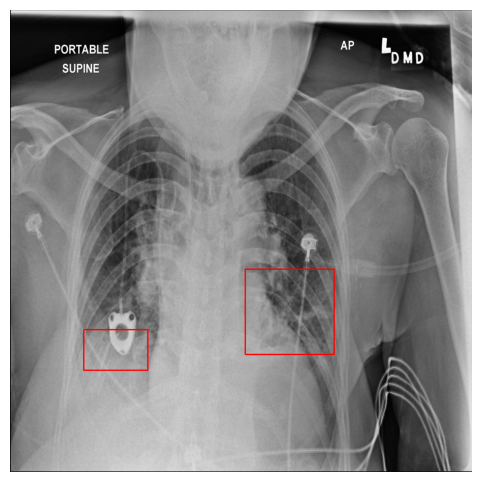

Patient ID: 08307845-ccbd-4616-b8e9-58532a766dbe | File: 08307845-ccbd-4616-b8e9-58532a766dbe.jpg


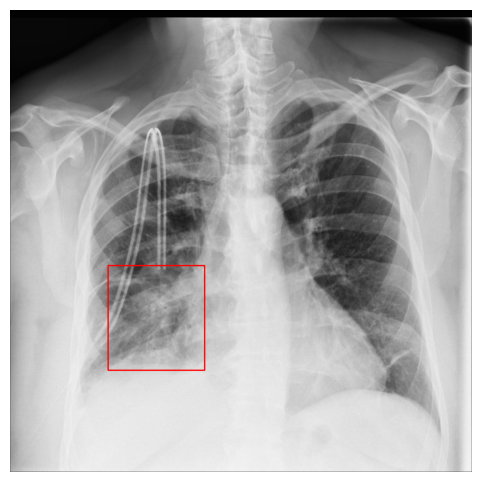

Patient ID: fea6191a-f4d4-4cc6-8bf7-5e81bd097209 | File: fea6191a-f4d4-4cc6-8bf7-5e81bd097209.jpg


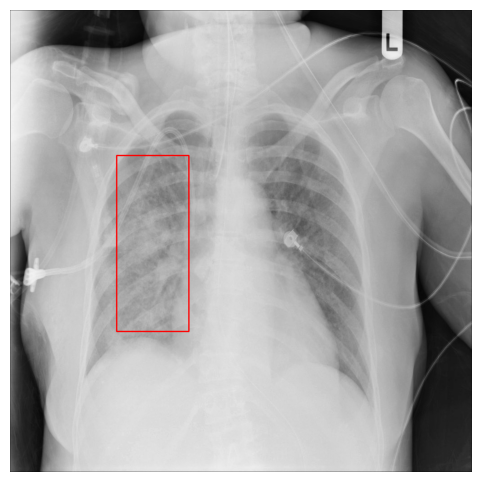

Patient ID: 99239481-5f84-4fe9-aa79-dfa79d3e7ae0 | File: 99239481-5f84-4fe9-aa79-dfa79d3e7ae0_vflip.jpg


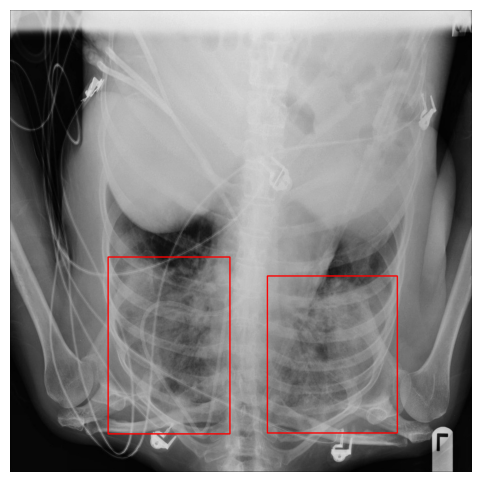

Patient ID: f50616b4-c6ab-44bc-8a70-28464c77c397 | File: f50616b4-c6ab-44bc-8a70-28464c77c397_vflip.jpg


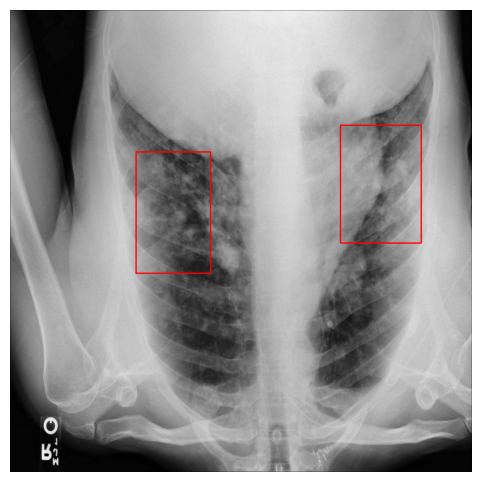

Patient ID: 4f5bd645-8b4a-4377-9e31-1ee3b5ef0286 | File: 4f5bd645-8b4a-4377-9e31-1ee3b5ef0286.jpg


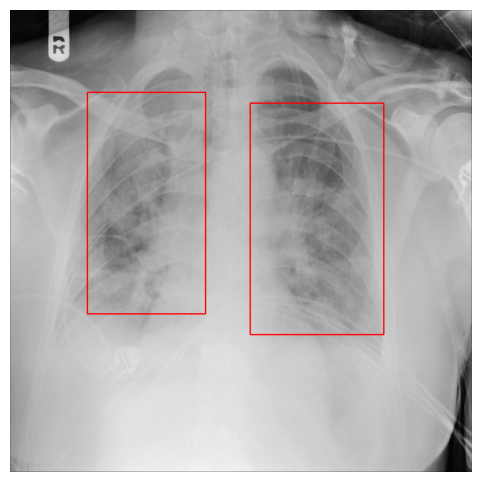

Patient ID: 51b0e89f-608a-4040-9d0d-694ebe072c28 | File: 51b0e89f-608a-4040-9d0d-694ebe072c28_hflip.jpg


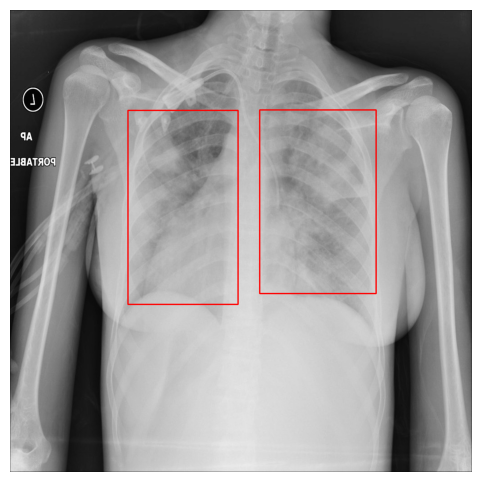

Patient ID: a61c9969-4521-4436-85e7-0fcb71e61dd4 | File: a61c9969-4521-4436-85e7-0fcb71e61dd4_hflip.jpg


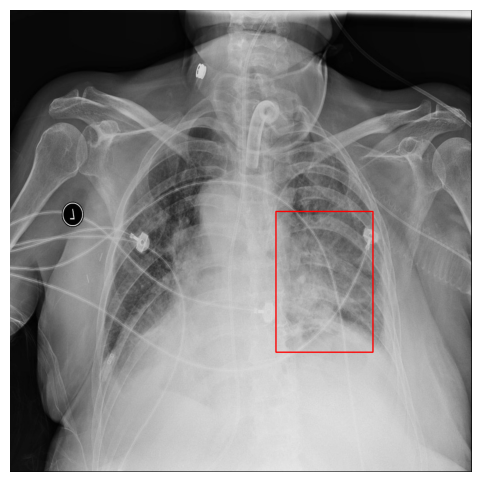

Patient ID: 35ffa64a-fc84-4582-95ad-40d4eab93197 | File: 35ffa64a-fc84-4582-95ad-40d4eab93197_vflip.jpg


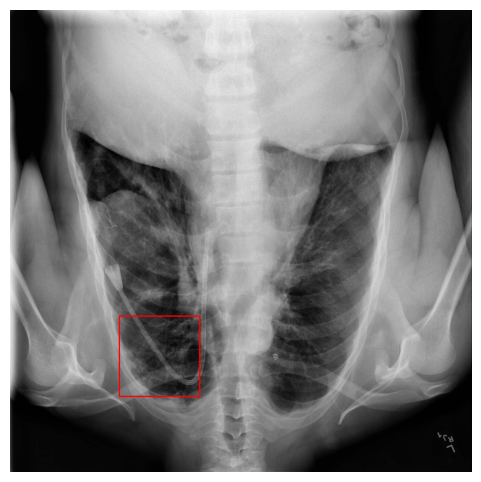

Patient ID: 83d25ba1-ba1c-4d32-b505-5cf0cffeff4c | File: 83d25ba1-ba1c-4d32-b505-5cf0cffeff4c_hflip.jpg


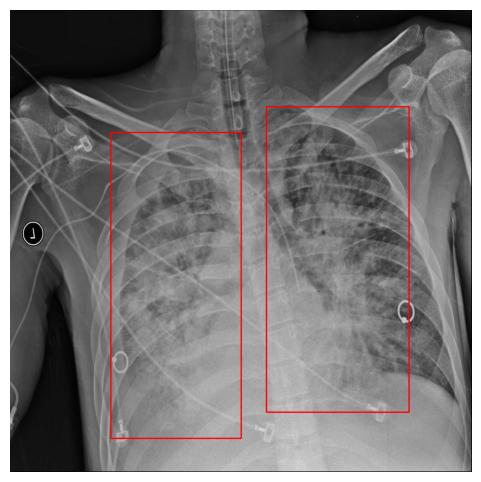

Patient ID: 7817b551-d220-479b-815f-395f83e1dba1 | File: 7817b551-d220-479b-815f-395f83e1dba1_vflip.jpg


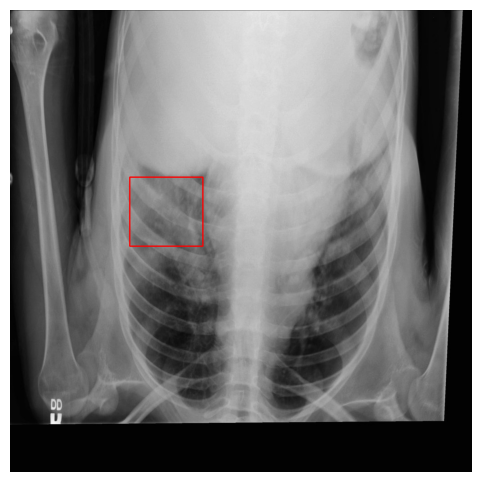

Patient ID: e15ecf55-b05a-4f6f-bb25-d51d4a438963 | File: e15ecf55-b05a-4f6f-bb25-d51d4a438963_hflip.jpg


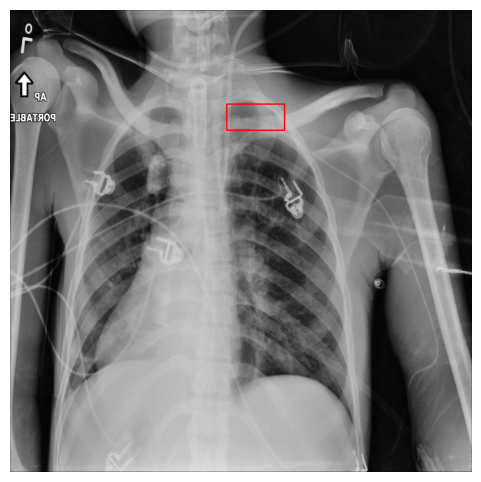

Patient ID: 3c51d6fa-6fb9-41b9-b723-25121b75c306 | File: 3c51d6fa-6fb9-41b9-b723-25121b75c306.jpg


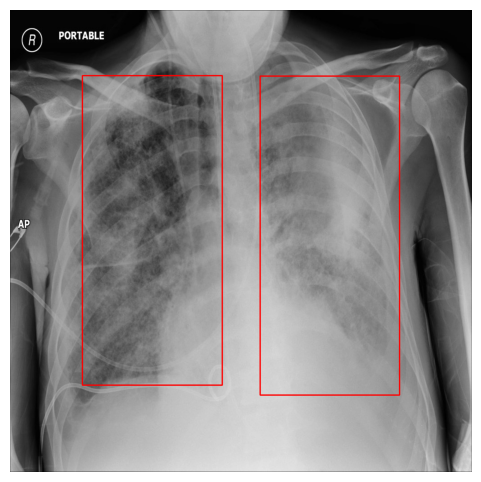

Patient ID: bf999eaa-6bce-46f8-be87-1dc34ca20e97 | File: bf999eaa-6bce-46f8-be87-1dc34ca20e97.jpg


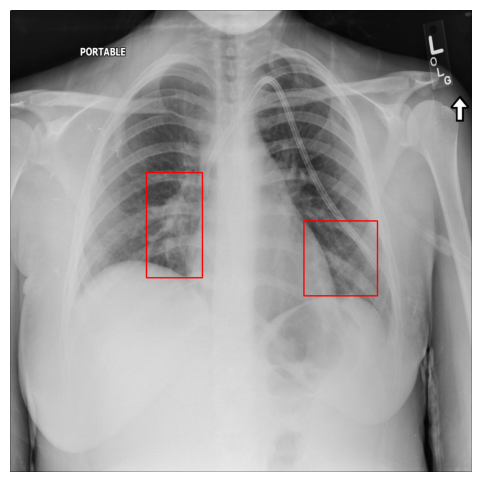

Patient ID: 73b46983-7780-4d82-874a-d9255dd639cb | File: 73b46983-7780-4d82-874a-d9255dd639cb_vflip.jpg


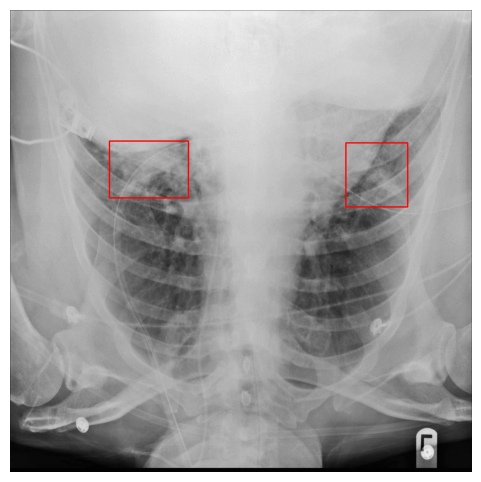

Patient ID: 0ecd1c28-bf25-4d32-979c-448356e0edb4 | File: 0ecd1c28-bf25-4d32-979c-448356e0edb4_vflip.jpg


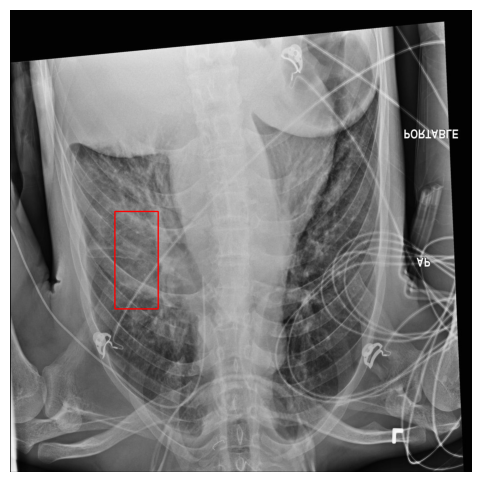

Patient ID: 45efba63-8fe8-4f5f-9adb-6d2eca3f12f5 | File: 45efba63-8fe8-4f5f-9adb-6d2eca3f12f5_vflip.jpg


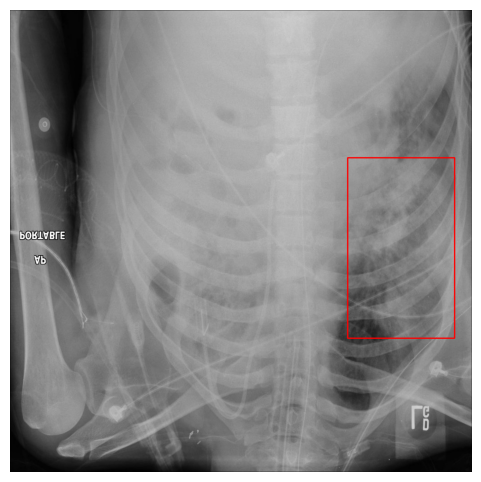

Patient ID: a7caec7a-dd5a-48af-ab0e-817aa2617b9f | File: a7caec7a-dd5a-48af-ab0e-817aa2617b9f_vflip.jpg


KeyboardInterrupt: 

In [ ]:
#Menampilkan Hasil Augmentasi Flip Data CSV
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import os

# ====== CONFIG ======
img_dir = "/content/train_aug"       # Folder augmentasi
csv_file = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"  # CSV asli berisi bounding box
patient_ids_to_show = None  # List patientId yang ingin ditampilkan, None = semua

# Load CSV
df = pd.read_csv(csv_file)

# Ambil file gambar augmentasi
files = [f for f in os.listdir(img_dir) if f.endswith(".jpg")]

# Fungsi menampilkan gambar dengan bounding box
def show_img_with_boxes(img_path, boxes):
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)

    for box in boxes:
        x_min, y_min, x_max, y_max = box
        cv2.rectangle(img, (int(x_min), int(y_min)), (int(x_max), int(y_max)), (255,0,0), 2)

    plt.figure(figsize=(6,6))
    plt.imshow(img)
    plt.axis("off")
    plt.show()

# Loop untuk menampilkan semua gambar
for file in files:
    pid = file.replace(".jpg","").replace("_hflip","").replace("_vflip","")

    if patient_ids_to_show is not None and pid not in patient_ids_to_show:
        continue  # skip jika tidak termasuk list

    img_path = os.path.join(img_dir, file)

    # Ambil bounding box asli dari CSV
    rows = df[df.patientId == pid]
    boxes = rows[['x','y','width','height']].values
    boxes[:,2] += boxes[:,0]  # x_max
    boxes[:,3] += boxes[:,1]  # y_max

    h, w = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE).shape

    # Flip bounding box jika diperlukan
    if "_hflip" in file:
        x_min = boxes[:,0].copy()
        x_max = boxes[:,2].copy()
        boxes[:,0] = w - x_max
        boxes[:,2] = w - x_min

    if "_vflip" in file:
        y_min = boxes[:,1].copy()
        y_max = boxes[:,3].copy()
        boxes[:,1] = h - y_max
        boxes[:,3] = h - y_min

    # Tampilkan gambar dengan bounding box
    print(f"Patient ID: {pid} | File: {file}")
    show_img_with_boxes(img_path, boxes)


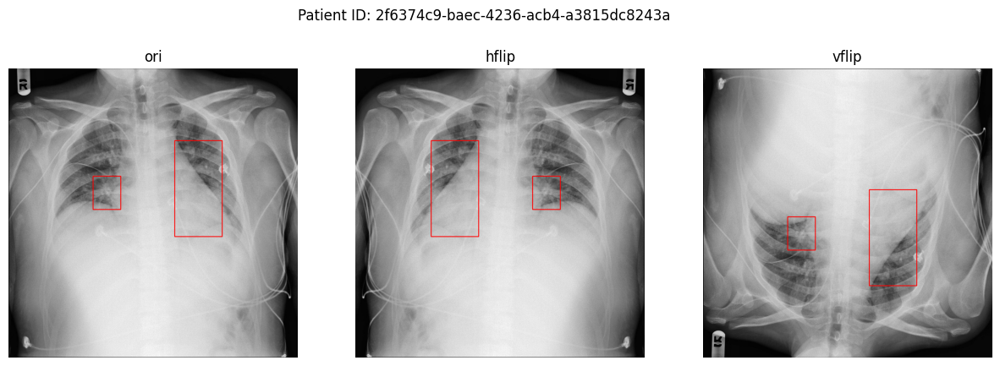

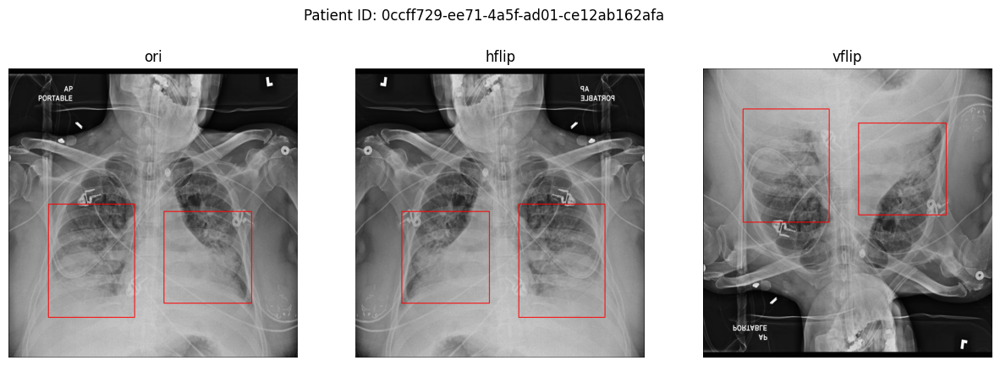

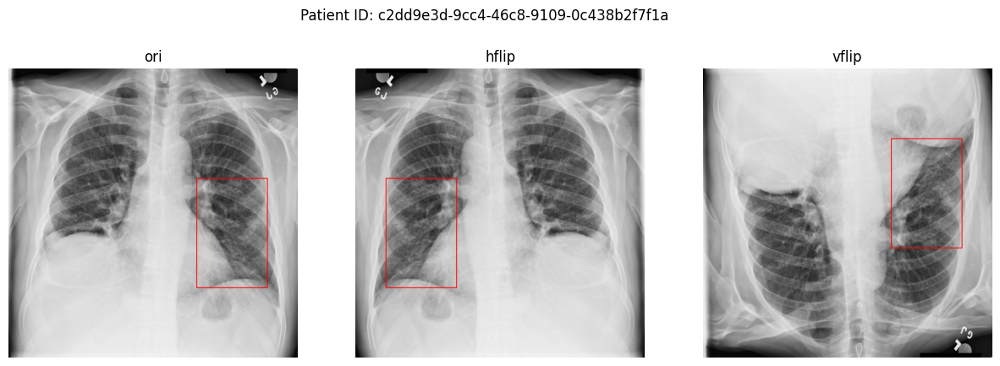

In [36]:
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import os

# ====== CONFIG ======
img_dir = "/content/train_aug"       # Folder augmentasi
csv_file = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"  # CSV asli
patient_ids_to_show = None  # None = ambil otomatis beberapa patient
num_examples = 3  # jumlah patientId yang ditampilkan

# Load CSV
df = pd.read_csv(csv_file)

# Ambil file gambar augmentasi
files = [f for f in os.listdir(img_dir) if f.endswith(".jpg")]

# Buat dict: patientId -> list file (ori, hflip, vflip)
from collections import defaultdict
pid_files = defaultdict(dict)

for file in files:
    pid = file.replace(".jpg","").replace("_hflip","").replace("_vflip","")
    if "_hflip" in file:
        pid_files[pid]['hflip'] = file
    elif "_vflip" in file:
        pid_files[pid]['vflip'] = file
    else:
        pid_files[pid]['ori'] = file

# Ambil patientId yang akan ditampilkan
all_pids = list(pid_files.keys()) if patient_ids_to_show is None else patient_ids_to_show
all_pids = all_pids[:num_examples]  # batasi jumlah

# Fungsi untuk load bounding box dan flip jika perlu
def get_boxes(file_name, pid):
    rows = df[df.patientId == pid]
    boxes = rows[['x','y','width','height']].values
    boxes[:,2] += boxes[:,0]  # x_max
    boxes[:,3] += boxes[:,1]  # y_max

    img_path = os.path.join(img_dir, file_name)
    h, w = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE).shape

    # Flip bbox jika perlu
    if "_hflip" in file_name:
        x_min = boxes[:,0].copy()
        x_max = boxes[:,2].copy()
        boxes[:,0] = w - x_max
        boxes[:,2] = w - x_min

    if "_vflip" in file_name:
        y_min = boxes[:,1].copy()
        y_max = boxes[:,3].copy()
        boxes[:,1] = h - y_max
        boxes[:,3] = h - y_min

    return img_path, boxes

# Fungsi untuk menampilkan 3 jenis gambar secara horizontal
def show_patient_images(pid):
    fig, axes = plt.subplots(1, 3, figsize=(15,5))

    for i, kind in enumerate(['ori','hflip','vflip']):
        if kind not in pid_files[pid]:
            axes[i].axis('off')
            continue
        file_name = pid_files[pid][kind]
        img_path, boxes = get_boxes(file_name, pid)
        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)

        for box in boxes:
            x_min, y_min, x_max, y_max = box
            cv2.rectangle(img, (int(x_min), int(y_min)), (int(x_max), int(y_max)), (255,0,0), 2)

        axes[i].imshow(img)
        axes[i].axis('off')
        axes[i].set_title(kind)

    plt.suptitle(f"Patient ID: {pid}")
    plt.show()

# Tampilkan contoh
for pid in all_pids:
    show_patient_images(pid)


In [34]:
#Diagram Sebelum dan Sesudah Augmentasi bagian Training set Per Bounding Box
import pandas as pd

# =========================
# Hitung jumlah bbox per patient (TRAIN)
# =========================
bbox_per_patient = (
    train_df
    .groupby("patientId")
    .size()
)

# Distribusi: bbox_count -> jumlah gambar
dist_before = bbox_per_patient.value_counts().sort_index()

dist_before

,count
1,2091
2,2613
3,95
4,10


In [35]:
# Karena augmentasi: asli + hflip + vflip
dist_after = dist_before * 3

dist_after

,count
1,6273
2,7839
3,285
4,30


In [36]:
dist_df = pd.DataFrame({
    "Bounding Box per Gambar": dist_before.index,
    "Sebelum Augmentasi": dist_before.values,
    "Sesudah Augmentasi": dist_after.values
})

dist_df

,Bounding Box per Gambar,Sebelum Augmentasi,Sesudah Augmentasi
0,1,2091,6273
1,2,2613,7839
2,3,95,285
3,4,10,30


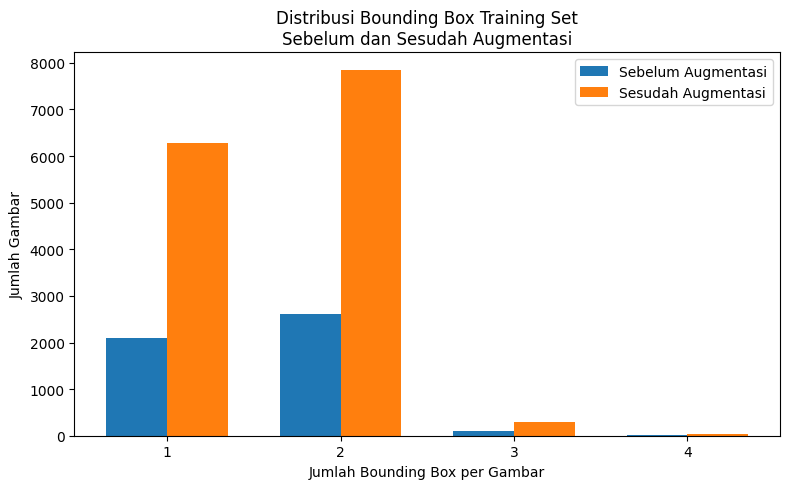

In [37]:
import matplotlib.pyplot as plt
import numpy as np

x = np.arange(len(dist_df))
width = 0.35

plt.figure(figsize=(8,5))
plt.bar(x - width/2, dist_df["Sebelum Augmentasi"], width, label="Sebelum Augmentasi")
plt.bar(x + width/2, dist_df["Sesudah Augmentasi"], width, label="Sesudah Augmentasi")

plt.xticks(x, dist_df["Bounding Box per Gambar"])
plt.xlabel("Jumlah Bounding Box per Gambar")
plt.ylabel("Jumlah Gambar")
plt.title("Distribusi Bounding Box Training Set\nSebelum dan Sesudah Augmentasi")
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
#PEMBUATAN MODEL

In [38]:
# ==============================================================================
# CELL 1: IMPORTS
# ==============================================================================

from collections import OrderedDict
from typing import Dict, List, Optional, Tuple

import torch
import torch.nn as nn
import torch.nn.functional as F
import timm

# Torchvision detection components
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator, RPNHead
from torchvision.models.detection.backbone_utils import BackboneWithFPN
from torchvision.ops import FeaturePyramidNetwork
from torchvision.ops.feature_pyramid_network import LastLevelMaxPool

In [39]:
# ==============================================================================
# CELL 2: EFFICIENTNETV2 BACKBONE WRAPPER
# ==============================================================================

class EfficientNetV2Backbone(nn.Module):
    """
    EfficientNetV2 backbone wrapper for object detection.

    Uses timm's `features_only=True` mode to extract intermediate feature maps
    at multiple scales, which are essential for FPN.

    EfficientNetV2-S Architecture Output Channels:
    - Stage 0: 24 channels  (1/2 resolution)
    - Stage 1: 48 channels  (1/4 resolution)
    - Stage 2: 64 channels  (1/8 resolution)
    - Stage 3: 128 channels (1/16 resolution)
    - Stage 4: 160 channels (1/32 resolution)
    - Stage 5: 256 channels (1/32 resolution)

    We use stages 2-5 for FPN (1/8 to 1/32 resolution) as is standard practice.
    Earlier stages have too high resolution and would be memory-intensive.
    """

    def __init__(
        self,
        model_name: str = 'tf_efficientnet_b0',
        pretrained: bool = True,
        out_indices: Tuple[int, ...] = (2, 3, 4, 5),
        freeze_bn: bool = False
    ):
        """
        Initialize EfficientNetV2 backbone.

        Args:
            model_name: timm model name (tf_efficientnetv2_s, tf_efficientnetv2_m, etc.)
            pretrained: Use ImageNet pretrained weights
            out_indices: Which feature stages to output (0-indexed)
            freeze_bn: Freeze BatchNorm layers (useful for small batch sizes)
        """
        super().__init__()

        # Create timm model with feature extraction mode
        self.body = timm.create_model(
            model_name,
            pretrained=pretrained,
            features_only=True,
            out_indices=out_indices
        )

        # Get output channel dimensions for each stage
        # This is critical for connecting to FPN
        self.out_channels_list = self.body.feature_info.channels()
        self.out_indices = out_indices

        print(f"EfficientNetV2 Backbone initialized:")
        print(f"  Model: {model_name}")
        print(f"  Output stages: {out_indices}")
        print(f"  Output channels: {self.out_channels_list}")

        # Optionally freeze BatchNorm
        # Recommended for batch_size < 4 to prevent BN stats corruption
        if freeze_bn:
            self._freeze_bn()

    def _freeze_bn(self):
        """Freeze all BatchNorm layers."""
        for module in self.modules():
            if isinstance(module, (nn.BatchNorm2d, nn.SyncBatchNorm)):
                module.eval()
                for param in module.parameters():
                    param.requires_grad = False

    def forward(self, x: torch.Tensor) -> Dict[str, torch.Tensor]:
        """
        Forward pass returning multi-scale features.

        Args:
            x: Input tensor of shape (B, 3, H, W)

        Returns:
            OrderedDict mapping feature names to tensors
            Keys are '0', '1', '2', '3' corresponding to out_indices
        """
        # Get features from all specified stages
        features = self.body(x)

        # Convert to OrderedDict with string keys (required by FPN)
        out = OrderedDict()
        for idx, feat in enumerate(features):
            out[str(idx)] = feat

        return out

    @property
    def out_channels(self) -> int:
        """Return the number of output channels after FPN (unified)."""
        # FPN unifies all channels to the same dimension
        # We'll set this in the full model
        return 256


In [40]:
# ==============================================================================
# CELL 3: CUSTOM FPN WITH EFFICIENTNETV2
# ==============================================================================

class EfficientNetV2WithFPN(nn.Module):
    """
    EfficientNetV2 backbone combined with Feature Pyramid Network.

    WHY FPN?
    ========
    1. Multi-scale detection: Pneumonia opacities vary greatly in size
    2. Combines low-level (edges, textures) and high-level (semantic) features
    3. Standard in all modern object detectors (Faster R-CNN, RetinaNet, YOLO)

    FPN Architecture:
    - Takes multi-scale features from backbone (C2, C3, C4, C5)
    - Creates pyramid features (P2, P3, P4, P5) with same channel dimension
    - Adds top-down pathway with lateral connections
    - Optionally adds P6 via max pooling for very large objects
    """

    def __init__(
        self,
        backbone_name: str = 'tf_efficientnet_b0',
        pretrained: bool = True,
        fpn_out_channels: int = 256,
        freeze_bn: bool = False,
        extra_blocks: bool = False,
    ):
        """
        Initialize backbone + FPN.

        Args:
            backbone_name: timm model name
            pretrained: Use pretrained weights
            fpn_out_channels: Number of channels in FPN output (256 is standard)
            freeze_bn: Freeze BatchNorm layers
            extra_blocks: Add extra max-pool level (P6)
        """
        super().__init__()

        # Create backbone
        self.backbone = EfficientNetV2Backbone(
            model_name=backbone_name,
            pretrained=pretrained,
            out_indices=(1, 2, 3, 4),  # Use stages with 1/8 to 1/32 resolution
            freeze_bn=freeze_bn
        )

        # Get input channels for FPN from backbone
        in_channels_list = self.backbone.out_channels_list

        # Create FPN
        # extra_blocks adds P6 level for detecting large objects
        extra = LastLevelMaxPool() if extra_blocks else None

        self.fpn = FeaturePyramidNetwork(
            in_channels_list=in_channels_list,
            out_channels=fpn_out_channels,
            extra_blocks=None
        )

        # Store output channels for detection head
        self.out_channels = fpn_out_channels

        print(f"\nFPN initialized:")
        print(f"  Input channels: {in_channels_list}")
        print(f"  Output channels: {fpn_out_channels}")
        print(f"  Extra P6 level: {extra_blocks}")

    def forward(self, x: torch.Tensor) -> Dict[str, torch.Tensor]:
        """
        Forward pass through backbone and FPN.

        Args:
            x: Input tensor (B, 3, H, W)

        Returns:
            Dictionary of FPN features {'0': P2, '1': P3, '2': P4, '3': P5, 'pool': P6}
        """
        # Extract multi-scale features from backbone
        backbone_features = self.backbone(x)

        # Pass through FPN
        fpn_features = self.fpn(backbone_features)

        return fpn_features



In [41]:
def create_anchor_generator() -> AnchorGenerator:
    """
    Anchor generator adapted from pneumonia X-ray analysis using K-Means++.
    Anchor scales are based on clustered bounding box sizes in the dataset.
    """

    # 3 anchor sizes (derived from dataset statistics)
    # mapped to FPN levels (P3, P4, P5)
    anchor_sizes = (
        (32,),    # small pneumonia regions
        (64,),   # medium regions
        (128,),
        (256,),   # large regions
    )

    # Aspect ratios based on article
    aspect_ratios = (
        (0.5, 1.0, 2.0),
    ) * 4

    anchor_generator = AnchorGenerator(
        sizes=anchor_sizes,
        aspect_ratios=aspect_ratios
    )

    return anchor_generator


In [42]:
# ==============================================================================
# CELL 5: ROI POOLER CONFIGURATION
# ==============================================================================

def get_roi_pooler_config() -> Dict:
    """
    Configuration for RoI (Region of Interest) pooling.

    RoI Align is used instead of RoI Pool for better accuracy.
    It uses bilinear interpolation to avoid quantization artifacts.
    """
    return {
        'featmap_names': ['0', '1', '2', '3'],  # FPN levels to use
        'output_size': 7,  # Output spatial size (7x7 is standard)
        'sampling_ratio': 2  # Sampling points for RoI Align
    }



In [43]:
# ==============================================================================
# CELL 6: MAIN PNEUMONIA DETECTOR CLASS
# ==============================================================================

class PneumoniaDetector(nn.Module):
    """
    Complete Pneumonia Detection Model.

    Architecture:
    1. EfficientNetV2-S backbone (timm)
    2. Feature Pyramid Network
    3. Region Proposal Network (RPN)
    4. RoI Align + Detection Head (Faster R-CNN)

    This is a two-stage detector:
    - Stage 1 (RPN): Proposes candidate regions
    - Stage 2 (Detection): Classifies and refines boxes

    Configuration Notes:
    - num_classes=2: Background (0) + Pneumonia (1)
    - Image mean/std: ImageNet normalization (handled in dataset)
    - NMS threshold: 0.5 for RPN, 0.3 for detection (will use WBF post-hoc)
    """

    def __init__(
        self,
        backbone_name: str = 'tf_efficientnet_b0',
        num_classes: int = 2,  # Background + Pneumonia
        pretrained_backbone: bool = True,
        # RPN settings
        rpn_pre_nms_top_n_train: int = 2000,
        rpn_pre_nms_top_n_test: int = 1000,
        rpn_post_nms_top_n_train: int = 2000,
        rpn_post_nms_top_n_test: int = 1000,
        rpn_nms_thresh: float = 0.7,
        rpn_fg_iou_thresh: float = 0.7,
        rpn_bg_iou_thresh: float = 0.3,
        # Detection settings
        box_score_thresh: float = 0.05,  # Low threshold - filter with WBF later
        box_nms_thresh: float = 0.5,
        box_detections_per_img: int = 100,
        box_fg_iou_thresh: float = 0.5,
        box_bg_iou_thresh: float = 0.5,
        # Training settings
        freeze_bn: bool = True,  # Freeze BN for small batch sizes
        trainable_backbone_layers: int = 5,  # Fine-tune all layers
    ):
        super().__init__()

        self.num_classes = num_classes
        self.backbone_name = backbone_name

        print("=" * 60)
        print("INITIALIZING PNEUMONIA DETECTOR")
        print("=" * 60)

        # 1. Create backbone with FPN
        backbone_fpn = EfficientNetV2WithFPN(
            backbone_name=backbone_name,
            pretrained=pretrained_backbone,
            fpn_out_channels=256,
            freeze_bn=freeze_bn,
            extra_blocks=True  # Add P6 level
        )

        # 2. Create anchor generator
        anchor_generator = create_anchor_generator()

        # 3. Create RPN head
        # RPN predicts objectness and box deltas for each anchor
        rpn_head = RPNHead(
            in_channels=backbone_fpn.out_channels,
            num_anchors=anchor_generator.num_anchors_per_location()[0]
        )

        # 4. Create complete Faster R-CNN model
        self.model = FasterRCNN(
            backbone=backbone_fpn,
            num_classes=num_classes,
            # RPN parameters
            rpn_anchor_generator=anchor_generator,
            rpn_head=rpn_head,
            rpn_pre_nms_top_n_train=rpn_pre_nms_top_n_train,
            rpn_pre_nms_top_n_test=rpn_pre_nms_top_n_test,
            rpn_post_nms_top_n_train=rpn_post_nms_top_n_train,
            rpn_post_nms_top_n_test=rpn_post_nms_top_n_test,
            rpn_nms_thresh=rpn_nms_thresh,
            rpn_fg_iou_thresh=rpn_fg_iou_thresh,
            rpn_bg_iou_thresh=rpn_bg_iou_thresh,
            rpn_batch_size_per_image=256,
            rpn_positive_fraction=0.5,
            # Box parameters
            box_score_thresh=box_score_thresh,
            box_nms_thresh=box_nms_thresh,
            box_detections_per_img=box_detections_per_img,
            box_fg_iou_thresh=box_fg_iou_thresh,
            box_bg_iou_thresh=box_bg_iou_thresh,
            box_batch_size_per_image=512,
            box_positive_fraction=0.25,
        )

        print(f"\nFaster R-CNN initialized:")
        print(f"  Num classes: {num_classes}")
        print(f"  RPN NMS thresh: {rpn_nms_thresh}")
        print(f"  Box score thresh: {box_score_thresh}")
        print(f"  Box NMS thresh: {box_nms_thresh}")
        print("=" * 60)

    def forward(
        self,
        images: List[torch.Tensor],
        targets: Optional[List[Dict[str, torch.Tensor]]] = None
    ) -> Dict[str, torch.Tensor]:
        """
        Forward pass.

        In training mode:
            Returns loss dictionary {'loss_classifier', 'loss_box_reg',
                                     'loss_objectness', 'loss_rpn_box_reg'}

        In inference mode:
            Returns list of detection dictionaries per image
            [{'boxes': Tensor, 'labels': Tensor, 'scores': Tensor}, ...]

        Args:
            images: List of tensors, each (3, H, W)
            targets: List of target dicts (only needed for training)

        Returns:
            Losses (training) or detections (inference)
        """
        return self.model(images, targets)

    def get_trainable_parameters(
        self,
        lr_backbone: float = 1e-5,
        lr_fpn: float = 1e-4,
        lr_head: float = 1e-3
    ) -> List[Dict]:
        """
        Get parameter groups with different learning rates.

        WHY DIFFERENT LEARNING RATES?
        =============================
        - Backbone: Pretrained, needs small LR to preserve learned features
        - FPN: New layers, can use moderate LR
        - Detection head: New layers, highest LR for fast convergence

        This is called "discriminative learning rates" and is critical
        for fine-tuning pretrained models.
        """
        # Separate parameters by component
        backbone_params = []
        fpn_params = []
        head_params = []

        for name, param in self.model.named_parameters():
            if not param.requires_grad:
                continue

            if 'backbone.backbone' in name:
                backbone_params.append(param)
            elif 'backbone.fpn' in name:
                fpn_params.append(param)
            else:
                head_params.append(param)

        param_groups = [
            {'params': backbone_params, 'lr': lr_backbone, 'name': 'backbone'},
            {'params': fpn_params, 'lr': lr_fpn, 'name': 'fpn'},
            {'params': head_params, 'lr': lr_head, 'name': 'head'},
        ]

        print(f"\nParameter groups:")
        print(f"  Backbone: {len(backbone_params)} params, lr={lr_backbone}")
        print(f"  FPN: {len(fpn_params)} params, lr={lr_fpn}")
        print(f"  Head: {len(head_params)} params, lr={lr_head}")

        return param_groups

    def freeze_backbone(self, freeze: bool = True):
        """Freeze/unfreeze the backbone for transfer learning."""
        for param in self.model.backbone.backbone.parameters():
            param.requires_grad = not freeze
        print(f"Backbone {'frozen' if freeze else 'unfrozen'}")

    def freeze_bn(self):
        """Set all BatchNorm layers to eval mode."""
        for module in self.model.modules():
            if isinstance(module, (nn.BatchNorm2d, nn.SyncBatchNorm)):
                module.eval()

In [44]:
# ==============================================================================
# CELL 7: MODEL FACTORY (EFFICIENTNET-B0)
# ==============================================================================

def create_efficientnet_b0_fasterrcnn(
    num_classes: int = 2,
    pretrained: bool = True,
    **kwargs
) -> PneumoniaDetector:
    """
    Create Faster R-CNN with EfficientNet-B0 backbone.

    This configuration is used in this study for pneumonia detection
    from chest X-ray images.
    """
    return PneumoniaDetector(
        backbone_name='efficientnet_b0',  # atau 'tf_efficientnet_b0'
        num_classes=num_classes,
        pretrained_backbone=pretrained,
        **kwargs
    )


In [45]:
# ==============================================================================
# CELL 8: MODEL TESTING
# ==============================================================================

def test_model():
    """Test the model with dummy inputs."""
    print("\n" + "=" * 60)
    print("TESTING MODEL ARCHITECTURE")
    print("=" * 60)

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"\nDevice: {device}")

    # Create model
    model = create_efficientnet_b0_fasterrcnn(
        num_classes=2,
        pretrained=True
    )
    model = model.to(device)

    # Count parameters
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"\nTotal parameters: {total_params:,}")
    print(f"Trainable parameters: {trainable_params:,}")

    # Test forward pass (training mode)
    print("\n" + "-" * 40)
    print("Testing training forward pass...")
    model.train()

    # Create dummy batch
    batch_size = 2
    images = [torch.randn(3, 1024, 1024).to(device) for _ in range(batch_size)]
    targets = [
        {
            'boxes': torch.tensor([[100, 100, 300, 300], [400, 400, 600, 600]]).float().to(device),
            'labels': torch.tensor([1, 1]).long().to(device),
        }
        for _ in range(batch_size)
    ]

    # Forward pass
    #with torch.cuda.amp.autocast(enabled=torch.cuda.is_available()):
    with torch.amp.autocast('cuda', enabled=torch.cuda.is_available()):
    # forward pass training atau inference

        losses = model(images, targets)

    print(f"\nTraining losses:")
    for name, loss in losses.items():
        print(f"  {name}: {loss.item():.4f}")

    total_loss = sum(losses.values())
    print(f"  Total: {total_loss.item():.4f}")

    # Test forward pass (inference mode)
    print("\n" + "-" * 40)
    print("Testing inference forward pass...")
    model.eval()

    with torch.no_grad():
        with torch.amp.autocast('cuda', enabled=torch.cuda.is_available()):
            detections = model(images)

    print(f"\nInference results (per image):")
    for i, det in enumerate(detections):
        print(f"  Image {i}:")
        print(f"    Boxes: {det['boxes'].shape}")
        print(f"    Labels: {det['labels'].shape}")
        print(f"    Scores: {det['scores'].shape}")
        if len(det['scores']) > 0:
            print(f"    Top score: {det['scores'][0].item():.4f}")

    print("\n" + "=" * 60)
    print("MODEL TEST COMPLETE")
    print("=" * 60)

    return model


def print_model_summary(model: PneumoniaDetector):
    """Print a summary of model components."""
    print("\n" + "=" * 60)
    print("MODEL SUMMARY")
    print("=" * 60)

    print("\n1. BACKBONE (EfficientNetV2-B0)")
    backbone = model.model.backbone.backbone.body
    for i, (name, module) in enumerate(backbone.named_children()):
        if i < 3:  # Just show first few
            print(f"   {name}: {type(module).__name__}")
    print("   ...")

    print("\n2. FPN (Feature Pyramid Network)")
    fpn = model.model.backbone.fpn
    print(f"   Inner blocks: {len(fpn.inner_blocks)}")
    print(f"   Layer blocks: {len(fpn.layer_blocks)}")

    print("\n3. RPN (Region Proposal Network)")
    rpn = model.model.rpn
    print(f"   Anchor generator sizes: {rpn.anchor_generator.sizes}")

    print("\n4. ROI HEADS")
    roi_heads = model.model.roi_heads
    print(f"   Box predictor: {type(roi_heads.box_predictor).__name__}")

    print("=" * 60)

In [46]:
# ==============================================================================
# CELL 9: MAIN
# ==============================================================================

if __name__ == "__main__":
    model = test_model()
    print_model_summary(model)

    # Get parameter groups for optimizer
    param_groups = model.get_trainable_parameters(
        lr_backbone=1e-5,
        lr_fpn=1e-4,
        lr_head=1e-3
    )


TESTING MODEL ARCHITECTURE

Device: cuda
INITIALIZING PNEUMONIA DETECTOR


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model.safetensors:   0%|          | 0.00/21.4M [00:00<?, ?B/s]

EfficientNetV2 Backbone initialized:
  Model: efficientnet_b0
  Output stages: (1, 2, 3, 4)
  Output channels: [24, 40, 112, 320]

FPN initialized:
  Input channels: [24, 40, 112, 320]
  Output channels: 256
  Extra P6 level: True

Faster R-CNN initialized:
  Num classes: 2
  RPN NMS thresh: 0.7
  Box score thresh: 0.05
  Box NMS thresh: 0.5

Total parameters: 20,583,573
Trainable parameters: 20,544,117

----------------------------------------
Testing training forward pass...

Training losses:
  loss_classifier: 1.3026
  loss_box_reg: 0.0064
  loss_objectness: 0.7066
  loss_rpn_box_reg: 0.0250
  Total: 2.0406

----------------------------------------
Testing inference forward pass...

Inference results (per image):
  Image 0:
    Boxes: torch.Size([100, 4])
    Labels: torch.Size([100])
    Scores: torch.Size([100])
    Top score: 0.9987
  Image 1:
    Boxes: torch.Size([100, 4])
    Labels: torch.Size([100])
    Scores: torch.Size([100])
    Top score: 0.9980

MODEL TEST COMPLETE

MO

In [ ]:
#TRAINING ENGINE

In [47]:
!pip install matplotlib-venn

In [48]:
!apt-get -qq install -y libfluidsynth1

E: Package 'libfluidsynth1' has no installation candidate


In [49]:
# https://pypi.python.org/pypi/libarchive
!apt-get -qq install -y libarchive-dev && pip install -U libarchive
import libarchive

Selecting previously unselected package libarchive-dev:amd64.
(Reading database ... 121689 files and directories currently installed.)
Preparing to unpack .../libarchive-dev_3.6.0-1ubuntu1.5_amd64.deb ...
Unpacking libarchive-dev:amd64 (3.6.0-1ubuntu1.5) ...
Setting up libarchive-dev:amd64 (3.6.0-1ubuntu1.5) ...
Processing triggers for man-db (2.10.2-1) ...
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.7/154.7 kB 6.2 MB/s eta 0:00:00
  Created wheel for libarchive: filename=libarchive-0.4.7-py3-none-any.whl size=31629 sha256=9bcf65858b5c4ec07a48ebdec1e42bfd43fc15273d28d877360e33f7bf4def01
  Stored in directory: /root/.cache/pip/wheels/29/20/ab/f101da7b245b996aa097685ef742243725ea6150f5b3b6d9ed
Successfully built libarchive


In [50]:
# https://pypi.python.org/pypi/pydot
!apt-get -qq install -y graphviz && pip install pydot
import pydot

In [51]:
!pip install cartopy
import cartopy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 123.5 MB/s eta 0:00:00


In [54]:
project_path = Path("..").resolve()
sys.path.append(str(project_path))
print("notebooks" in [p.name for p in project_path.iterdir()])


False


In [53]:

import sys
from pathlib import Path

# Path ke root project (folder yang berisi notebooks)
project_path = Path(".").resolve()
sys.path.append(str(project_path))

# Cek apakah Python sudah bisa melihat folder 'notebooks'
print("notebooks" in [p.name for p in project_path.iterdir()])  # harus True


False


In [52]:
# ==============================================================================
# CELL 1: IMPORTS
# ==============================================================================

import os
import sys
import time
import json
import logging
from datetime import datetime
from typing import Dict, List, Optional, Tuple
from pathlib import Path

import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.optim import AdamW
from torch.optim.lr_scheduler import CosineAnnealingWarmRestarts, ReduceLROnPlateau, OneCycleLR
from torch.cuda.amp import GradScaler, autocast
from tqdm import tqdm

# Import our modules
from notebooks.data_pipeline_01 import (
    Config, RSNADataset, prepare_data, create_dataloaders,
    get_train_transforms, get_valid_transforms, collate_fn,
    set_seed, get_fold_data
)
from notebooks.model_architecture_02 import (
    PneumoniaDetector, create_efficientnetv2_s_fasterrcnn
)
from notebooks.losses_and_utilities_03 import (
    FocalLoss, FocalLossWithLogits, focal_loss_for_rpn,
    apply_wbf, calculate_map, calculate_iou_matrix,
    EarlyStopping, AverageMeter
)

# Setup logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(levelname)s - %(message)s'
)
logger = logging.getLogger(__name__)


ModuleNotFoundError: No module named 'notebooks'

In [ ]:
#FEATURE MAP EFFISIENT NET-B0


In [ ]:
#
import torch
import torchvision.models as models
import torchvision.transforms as T
from PIL import Image
import matplotlib.pyplot as plt
import os

# ====== CONFIG ======
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
img_dir = "/content/train_aug"  # folder augmentasi

# ====== Load model EfficientNet-B0 pretrained ======
model = models.efficientnet_b0(pretrained=True).to(device)
model.eval()
feature_extractor = model.features  # ambil fitur sebelum classifier

# ====== Transform gambar ======
transform = T.Compose([
    T.Resize((224,224)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225])
])

# ====== Fungsi ambil feature map ======
def get_feature_map(img_path):
    img = Image.open(img_path).convert("RGB")
    img_tensor = transform(img).unsqueeze(0).to(device)
    with torch.no_grad():
        features = feature_extractor(img_tensor)
    return features  # shape: [1, C, H, W]

# ====== Loop semua gambar di train_aug ======
feature_maps = {}  # dictionary: patientId -> feature map

for file_name in os.listdir(img_dir):
    if not file_name.endswith(".jpg"):
        continue

    pid = file_name.replace(".jpg","").replace("_hflip","").replace("_vflip","")
    img_path = os.path.join(img_dir, file_name)

    features = get_feature_map(img_path)
    feature_maps[file_name] = features.cpu()  # simpan di CPU

print("Feature maps berhasil diekstrak untuk", len(feature_maps), "gambar.")


/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth


100%|██████████| 20.5M/20.5M [00:00<00:00, 160MB/s]


Feature maps berhasil diekstrak untuk 14427 gambar.


In [ ]:
#Visualisasi Feature Map (beberapa channel)
import matplotlib.pyplot as plt
import numpy as np

def visualize_feature_maps(feature_map, num_channels=8, title="Feature Map"):
    """
    feature_map: tensor [1, C, H, W]
    """
    fmap = feature_map.squeeze(0)  # [C, H, W]
    num_channels = min(num_channels, fmap.shape[0])

    fig, axes = plt.subplots(1, num_channels, figsize=(20,4))
    for i in range(num_channels):
        fm = fmap[i].cpu().numpy()
        axes[i].imshow(fm, cmap='viridis')
        axes[i].axis("off")
        axes[i].set_title(f"Ch {i}")

    plt.suptitle(title)
    plt.show()


Visualisasi feature map untuk: e2e0accf-73b4-4cc4-bc85-2066f1fa4762_hflip.jpg


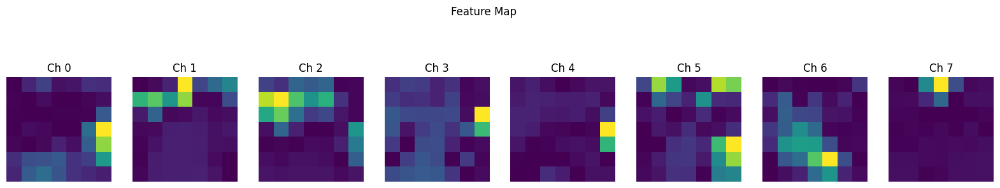

In [ ]:
# Ambil satu contoh gambar
sample_file = list(feature_maps.keys())[0]
sample_feature = feature_maps[sample_file]

print("Visualisasi feature map untuk:", sample_file)
visualize_feature_maps(sample_feature, num_channels=8)


In [ ]:
#Feature Map → Heatmap (Average Channel) -> Kode Heatmap Rata-rata Feature
def visualize_feature_heatmap(feature_map, title="Feature Heatmap"):
    fmap = feature_map.squeeze(0)  # [C, H, W]
    heatmap = fmap.mean(dim=0).cpu().numpy()  # average channel

    plt.figure(figsize=(6,6))
    plt.imshow(heatmap, cmap='jet')
    plt.colorbar()
    plt.title(title)
    plt.axis("off")
    plt.show()


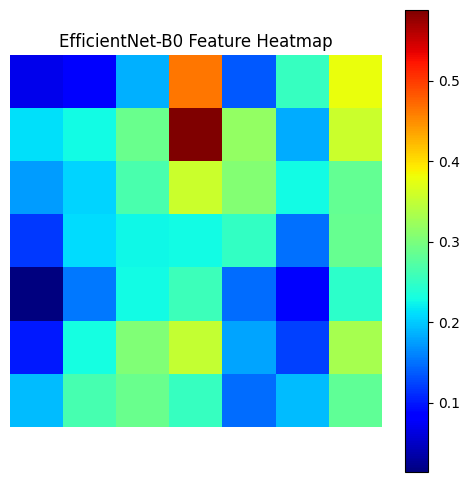

In [ ]:
visualize_feature_heatmap(sample_feature, title="EfficientNet-B0 Feature Heatmap")


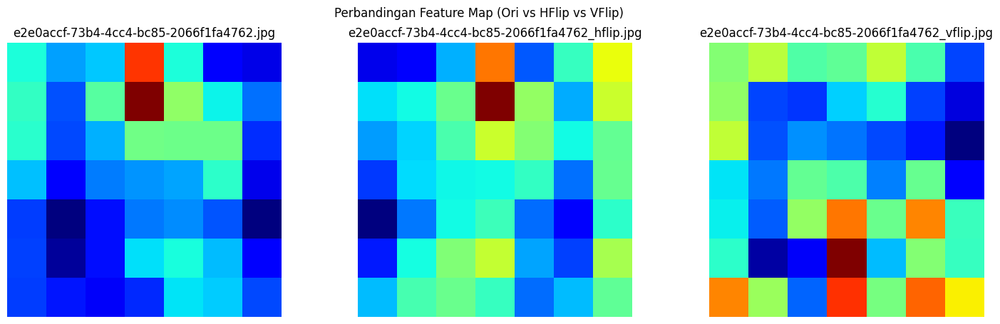

In [ ]:
#Membandingkan Original VS HFLIP VS VFLIP
pid = sample_file.replace(".jpg","").replace("_hflip","").replace("_vflip","")

files_to_compare = [
    f"{pid}.jpg",
    f"{pid}_hflip.jpg",
    f"{pid}_vflip.jpg"
]

fig, axes = plt.subplots(1,3, figsize=(18,5))

for i, f in enumerate(files_to_compare):
    if f not in feature_maps:
        axes[i].axis("off")
        continue

    fmap = feature_maps[f].squeeze(0).mean(dim=0).cpu().numpy()
    axes[i].imshow(fmap, cmap="jet")
    axes[i].set_title(f)
    axes[i].axis("off")

plt.suptitle("Perbandingan Feature Map (Ori vs HFlip vs VFlip)")
plt.show()


In [ ]:
#Overlay Heatmap ke Gambar Asli
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

def overlay_heatmap_on_image(img_path, feature_map, alpha=0.5):
    """
    img_path    : path gambar asli
    feature_map : tensor [1, C, H, W]
    alpha       : transparansi heatmap
    """

    # === Load image asli ===
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    img_color = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)

    # === Buat heatmap dari feature map ===
    fmap = feature_map.squeeze(0)
    heatmap = fmap.mean(dim=0).cpu().numpy()

    # Normalisasi heatmap
    heatmap -= heatmap.min()
    heatmap /= heatmap.max() + 1e-8

    # Resize heatmap ke ukuran image
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # Convert ke colormap
    heatmap_color = cv2.applyColorMap(
        np.uint8(255 * heatmap),
        cv2.COLORMAP_JET
    )

    # Overlay heatmap ke image
    overlay = cv2.addWeighted(img_color, 1 - alpha, heatmap_color, alpha, 0)

    # === Tampilkan ===
    plt.figure(figsize=(15,5))

    plt.subplot(1,3,1)
    plt.imshow(img_color)
    plt.title("Gambar Asli")
    plt.axis("off")

    plt.subplot(1,3,2)
    plt.imshow(heatmap_color)
    plt.title("Feature Heatmap")
    plt.axis("off")

    plt.subplot(1,3,3)
    plt.imshow(overlay)
    plt.title("Overlay (Asli + Heatmap)")
    plt.axis("off")

    plt.show()


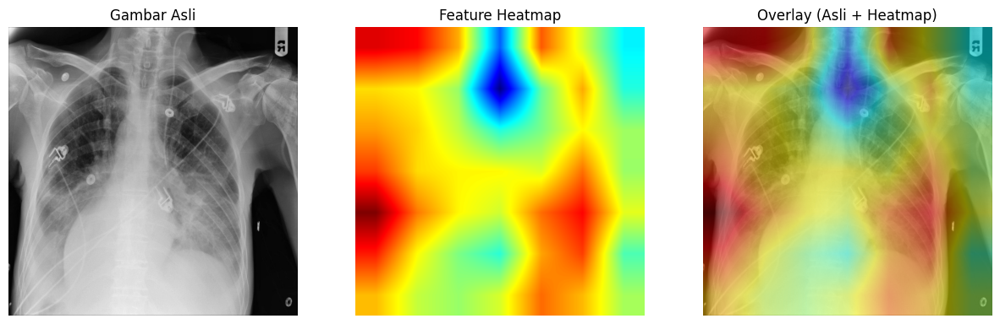

In [ ]:
# Ambil satu contoh file
sample_file = list(feature_maps.keys())[0]
sample_feature = feature_maps[sample_file]

img_path = os.path.join("/content/train_aug", sample_file)

overlay_heatmap_on_image(img_path, sample_feature, alpha=0.5)


In [ ]:
#FPN

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class FPN(nn.Module):
    def __init__(self, in_channels_list, out_channels):
        super().__init__()

        self.lateral_convs = nn.ModuleList([
            nn.Conv2d(in_ch, out_channels, kernel_size=1)
            for in_ch in in_channels_list
        ])

        self.output_convs = nn.ModuleList([
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
            for _ in in_channels_list
        ])

    def forward(self, features):
        c3, c4, c5 = features

        p5 = self.lateral_convs[2](c5)
        p4 = self.lateral_convs[1](c4) + F.interpolate(p5, scale_factor=2, mode="nearest")
        p3 = self.lateral_convs[0](c3) + F.interpolate(p4, scale_factor=2, mode="nearest")

        p5 = self.output_convs[2](p5)
        p4 = self.output_convs[1](p4)
        p3 = self.output_convs[0](p3)

        return p3, p4, p5


In [ ]:
#EfficientNet-B0 BACKBONE
import torch
import torch.nn as nn
from torchvision.models import efficientnet_b0, EfficientNet_B0_Weights

class EfficientNetBackbone(nn.Module):
    def __init__(self):
        super().__init__()
        backbone = efficientnet_b0(weights=EfficientNet_B0_Weights.DEFAULT)
        self.features = backbone.features

    def forward(self, x):
        x = self.features[0](x)   # 32
        x = self.features[1](x)   # 16
        x = self.features[2](x)   # 24
        x = self.features[3](x)   # 40
        c3 = x                    # ✅ 40

        x = self.features[4](x)   # 80
        c4 = x                    # ✅ 80

        x = self.features[5](x)   # 112
        x = self.features[6](x)   # 192
        x = self.features[7](x)   # 320
        x = self.features[8](x)   # 1280
        c5 = x                    # ✅ 1280

        return c3, c4, c5


In [ ]:
#Test Backbone dulu
x = torch.randn(1, 3, 224, 224)
backbone = EfficientNetBackbone()

c3, c4, c5 = backbone(x)
print(c3.shape, c4.shape, c5.shape)

torch.Size([1, 40, 28, 28]) torch.Size([1, 80, 14, 14]) torch.Size([1, 1280, 7, 7])


In [ ]:
#EfficientNet + FPN
class EfficientNetFPN(nn.Module):
    def __init__(self):
        super().__init__()
        self.backbone = EfficientNetBackbone()
        self.fpn = FPN(
            in_channels_list=[40, 80, 1280],  # WAJIB INI
            out_channels=256
        )

    def forward(self, x):
        c3, c4, c5 = self.backbone(x)
        return self.fpn([c3, c4, c5])


In [ ]:
#TEST CEPAT (TANPA DATASET)
x = torch.randn(1, 3, 224, 224)
model = EfficientNetFPN()

p3, p4, p5 = model(x)

print(p3.shape)
print(p4.shape)
print(p5.shape)


torch.Size([1, 256, 28, 28])
torch.Size([1, 256, 14, 14])
torch.Size([1, 256, 7, 7])


In [ ]:
#Proses Visualisasi P3, P4, P5
import numpy as np
import cv2
import matplotlib.pyplot as plt

def visualize_fpn(img_pil, feature_map, title):
    """
    img_pil     : PIL Image (RGB)
    feature_map : Tensor [1, C, H, W]
    """

    # Feature map → numpy
    fmap = feature_map.squeeze(0).mean(dim=0).detach().cpu().numpy()

    # Normalisasi 0–1
    fmap = (fmap - fmap.min()) / (fmap.max() - fmap.min() + 1e-6)

    # Resize ke ukuran gambar
    fmap = cv2.resize(fmap, img_pil.size)

    # Heatmap
    heatmap = cv2.applyColorMap(np.uint8(255 * fmap), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)

    # Overlay
    img_np = np.array(img_pil)
    overlay = (0.6 * img_np + 0.4 * heatmap).astype(np.uint8)

    # Plot
    plt.figure(figsize=(5,5))
    plt.imshow(overlay)
    plt.title(title)
    plt.axis("off")
    plt.show()


In [ ]:
#AMBIL 1 GAMBAR DARI train_aug
from PIL import Image
import torchvision.transforms as T
import torch
import os

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

transform = T.Compose([
    T.Resize((224,224)),
    T.ToTensor(),
    T.Normalize(mean=[0.485,0.456,0.406],
                std=[0.229,0.224,0.225])
])

img_file = os.listdir("/content/train_aug")[0]
img_path = os.path.join("/content/train_aug", img_file)

img = Image.open(img_path).convert("RGB")
x = transform(img).unsqueeze(0).to(device)


In [ ]:
#Menampilkan pastienID yang dipake sebagai contoh
import os
from PIL import Image

img_dir = "/content/train_aug"
img_file = os.listdir(img_dir)[0]

patient_id = img_file.split("_")[0]
print("File:", img_file)
print("Patient ID:", patient_id)

img = Image.open(os.path.join(img_dir, img_file))

File: e2e0accf-73b4-4cc4-bc85-2066f1fa4762_hflip.jpg
Patient ID: e2e0accf-73b4-4cc4-bc85-2066f1fa4762


In [ ]:
#FORWARD KE MODEL (BACKBONE + FPN)
model = EfficientNetFPN().to(device)
model.eval()

with torch.no_grad():
    p3, p4, p5 = model(x)


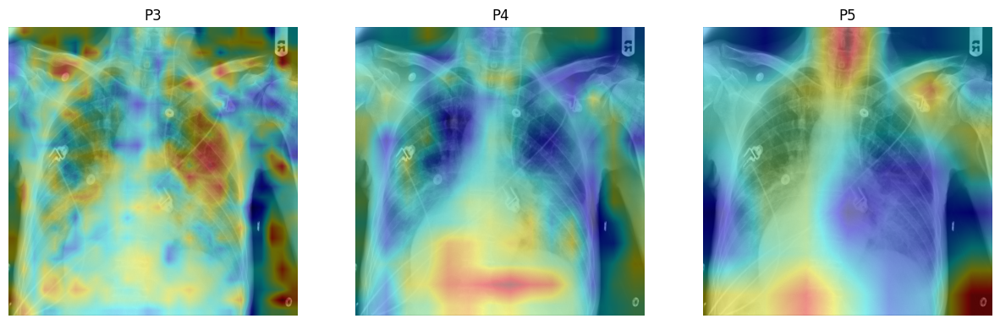

In [ ]:
#VISUALISASI P3–P5 MENYAMPING
import numpy as np
import cv2
import matplotlib.pyplot as plt

def overlay(img_pil, fmap):
    img_np = np.array(img_pil.convert("RGB"))  # ⬅️ INI KUNCINYA

    fmap = fmap.squeeze(0).mean(0).cpu().numpy()
    fmap = (fmap - fmap.min()) / (fmap.max() - fmap.min() + 1e-6)
    fmap = cv2.resize(fmap, (img_np.shape[1], img_np.shape[0]))

    heatmap = cv2.applyColorMap((fmap*255).astype(np.uint8), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)

    return (0.6*img_np + 0.4*heatmap).astype(np.uint8)

plt.figure(figsize=(15,5))
plt.subplot(1,3,1); plt.imshow(overlay(img, p3)); plt.title("P3"); plt.axis("off")
plt.subplot(1,3,2); plt.imshow(overlay(img, p4)); plt.title("P4"); plt.axis("off")
plt.subplot(1,3,3); plt.imshow(overlay(img, p5)); plt.title("P5"); plt.axis("off")
plt.show()



In [ ]:
#Tampilkan dengan bounding box p3-p5 ini

In [ ]:
#Ambil bounding box dari CSV (patientId yang sama)
import pandas as pd

csv_file = "/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv"
df = pd.read_csv(csv_file)

# Ambil patientId dari nama file (hapus _hflip/_vflip)
pid = img_file.replace(".jpg","").replace("_hflip","").replace("_vflip","")

rows = df[df.patientId == pid]

boxes = []
for _, row in rows.iterrows():
    if row["Target"] == 1:
        x_min = row["x"]
        y_min = row["y"]
        x_max = row["x"] + row["width"]
        y_max = row["y"] + row["height"]
        boxes.append([x_min, y_min, x_max, y_max])

In [ ]:
#Fungsi overlay heatmap + bounding box
def overlay_with_bbox(img_pil, fmap, boxes):
    # pastikan RGB
    img_np = np.array(img_pil.convert("RGB"))

    fmap = fmap.squeeze(0).mean(0).cpu().numpy()
    fmap = (fmap - fmap.min()) / (fmap.max() - fmap.min() + 1e-6)
    fmap = cv2.resize(fmap, (img_np.shape[1], img_np.shape[0]))

    heatmap = cv2.applyColorMap((fmap*255).astype(np.uint8), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)

    overlay = (0.6*img_np + 0.4*heatmap).astype(np.uint8)

    for x1,y1,x2,y2 in boxes:
        cv2.rectangle(overlay,(int(x1),int(y1)),(int(x2),int(y2)),(0,255,0),2)

    return overlay

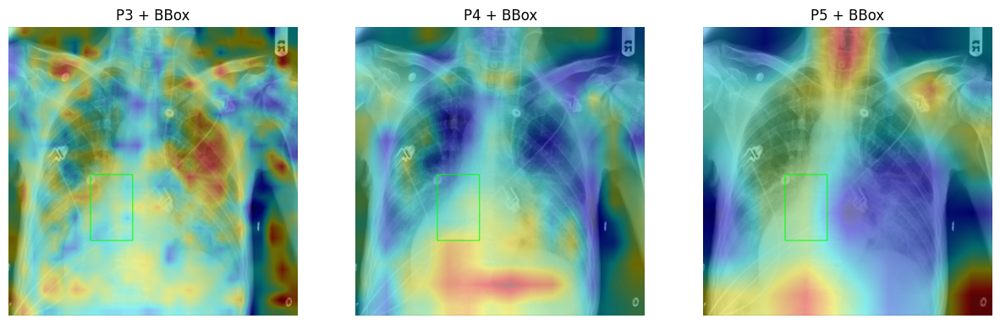

In [ ]:
#Visualisasi P3–P5 + bounding box (menyamping)
plt.figure(figsize=(15,5))
plt.subplot(1,3,1); plt.imshow(overlay_with_bbox(img, p3, boxes)); plt.title("P3 + BBox"); plt.axis("off")
plt.subplot(1,3,2); plt.imshow(overlay_with_bbox(img, p4, boxes)); plt.title("P4 + BBox"); plt.axis("off")
plt.subplot(1,3,3); plt.imshow(overlay_with_bbox(img, p5, boxes)); plt.title("P5 + BBox"); plt.axis("off")
plt.show()

In [ ]:
#MODEL FASTER R-CNN

In [ ]:
#Backbone + FPN khusus untuk Faster R-CNN
import torch
import torch.nn as nn
from collections import OrderedDict

class EfficientNetFPN_Backbone(nn.Module):
    def __init__(self):
        super().__init__()
        self.backbone = EfficientNetBackbone()
        self.fpn = FPN(
            in_channels_list=[40, 80, 1280],
            out_channels=256
        )
        self.out_channels = 256  # WAJIB untuk Faster R-CNN

    def forward(self, x):
        c3, c4, c5 = self.backbone(x)
        p3, p4, p5 = self.fpn([c3, c4, c5])

        return OrderedDict({
            "0": p3,
            "1": p4,
            "2": p5
        })


In [ ]:
#MEMBUAT FASTER R-CNN + RPN
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator


In [ ]:
#Anchor Generator (multi-scale, sesuai FPN)
anchor_generator = AnchorGenerator(
    sizes=((32,), (64,), (128,)),      # P3, P4, P5
    aspect_ratios=((0.5, 1.0, 2.0),) * 3
)


In [ ]:
#ROI Pooling
from torchvision.ops import MultiScaleRoIAlign

roi_pooler = MultiScaleRoIAlign(
    featmap_names=["0", "1", "2"],  # P3, P4, P5
    output_size=7,
    sampling_ratio=2
)


In [ ]:
#INISIALISASI FASTER R-CNN (FINAL)
from torchvision.models.detection import FasterRCNN

backbone = EfficientNetFPN_Backbone()

model = FasterRCNN(
    backbone=backbone,
    num_classes=2,  # background + pneumonia
    rpn_anchor_generator=anchor_generator,
    box_roi_pool=roi_pooler
)


In [ ]:
#DATASET CLASS (RSNA Detection Dataset)
class RSNAPneumoniaDataset(Dataset):
    def __init__(self, img_dir, csv_file, transforms=None):
        self.img_dir = img_dir
        self.df = pd.read_csv(csv_file)
        self.transforms = transforms

        # Ambil SEMUA file jpg di train_aug
        self.files = [f for f in os.listdir(img_dir) if f.endswith(".jpg")]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_name = self.files[idx]
        img_path = os.path.join(self.img_dir, file_name)

        # Ambil patientId ASLI dari nama file
        pid = file_name.replace(".jpg", "").replace("_hflip", "").replace("_vflip", "")

        # Load image
        img = Image.open(img_path).convert("RGB")

        # Ambil bbox dari CSV
        rows = self.df[self.df.patientId == pid]

        boxes = []
        labels = []

        for _, row in rows.iterrows():
            if row["Target"] == 1:
                x_min = row["x"]
                y_min = row["y"]
                x_max = row["x"] + row["width"]
                y_max = row["y"] + row["height"]

                boxes.append([x_min, y_min, x_max, y_max])
                labels.append(1)

        if len(boxes) == 0:
            boxes = torch.zeros((0, 4), dtype=torch.float32)
            labels = torch.zeros((0,), dtype=torch.int64)
        else:
            boxes = torch.tensor(boxes, dtype=torch.float32)
            labels = torch.tensor(labels, dtype=torch.int64)

        target = {
            "boxes": boxes,
            "labels": labels,
            "image_id": torch.tensor([idx])
        }

        if self.transforms:
            img = self.transforms(img)

        return img, target


In [ ]:
#TRANSFORM (KHUSUS DETECTION) -> (karena augmentasi sudah kamu lakukan di train_aug)
transform = T.Compose([
    T.ToTensor()
])


In [ ]:
#BUAT DATASET & DATALOADER
#COLLATE FUNCTION
def collate_fn(batch):
    return tuple(zip(*batch))


In [ ]:
#Inisialisasi
from torch.utils.data import DataLoader

train_dataset = RSNAPneumoniaDataset(
    img_dir="/content/train_aug",
    csv_file="/content/drive/MyDrive/RSNA_Pneumonia/stage_2_train_labels.csv",
    transforms=transform
)

train_loader = DataLoader(
    train_dataset,
    batch_size=2,      # aman untuk Colab
    shuffle=True,
    collate_fn=collate_fn
)


In [ ]:
#CEK DATA (WAJIB SEBELUM TRAINING)
images, targets = next(iter(train_loader))

print(images[0].shape)
print(targets[0])


torch.Size([3, 1024, 1024])
{'boxes': tensor([[134., 432., 384., 738.]]), 'labels': tensor([1]), 'image_id': tensor([2044])}


In [ ]:
#PERSIAPAN MODEL & OPTIMIZER
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)
model.train()

# Optimizer (sesuai Faster R-CNN standar)
params = [p for p in model.parameters() if p.requires_grad]

optimizer = torch.optim.SGD(
    params,
    lr=0.005,
    momentum=0.9,
    weight_decay=0.0005
)


In [ ]:
#TRAINING LOOP
from tqdm import tqdm

num_epochs = 7

for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0.0

    pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}")

    for images, targets in pbar:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        epoch_loss += losses.item()
        pbar.set_postfix(loss=losses.item())

    print(f"Epoch [{epoch+1}/{num_epochs}] - Total Loss: {epoch_loss:.4f}")


Epoch 1/7:   6%|▋         | 464/7214 [1:51:30<27:02:02, 14.42s/it, loss=0.46]


KeyboardInterrupt: 

In [ ]:
#SOFT NMS

In [ ]:
#PENGUJIAN MODEL

In [ ]:
#METRIK PENILAIAN